<img src="https://www.epfl.ch/about/overview/wp-content/uploads/2020/07/logo-epfl-1024x576.png" 
     style="padding-right:10px;width:140px;float:left">
<h2 style="white-space: nowrap">Neural Signal and Signal Processing (NX-421)</h2>
<hr style="clear:both">
<h1 style="color:black">Mini Project 2</h1>

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set() #sets the matplotlib style to seaborn style

from scipy.io import loadmat 
from scipy.ndimage import convolve1d
from scipy.signal import butter
from scipy.signal import sosfiltfilt
from scipy.signal import welch
import pandas as pd

# Part 1
## Visualization and preprocessing of the data

Important note: the data are partially preprocessed, i.e. already amplified, bandpass-filtered and RMS rectified. The signals were also cleaned  from 50 Hz (and harmonics) power-line interference using a Hampel filter. (faire référence au paper)

### Load the data

In [25]:
data_path = "data/s2/S2_A1_E1.mat"

data = loadmat(data_path)
print("Dataset variables:")
for key in data.keys():
    if not key.startswith("__"):
        print(key)

Dataset variables:
subject
exercise
stimulus
emg
glove
restimulus
repetition
rerepetition


In [5]:
emg = data["emg"]
print("EMG data dimension: {}".format(emg.shape))
print("EMG data type: {}".format(type(emg)))

EMG data dimension: (100686, 10)
EMG data type: <class 'numpy.ndarray'>


In [6]:
data_shape = emg.shape
n_timepoints = emg.shape[0]
n_channels = emg.shape[1]

print(f'The shape of the data is {data_shape}')
print(f'There are {n_timepoints} timepoints')
print(f'There are {n_channels} channels')

The shape of the data is (100686, 10)
There are 100686 timepoints
There are 10 channels


### Visualization of the EMG signal on one channel

Text(0, 0.5, 'Amplitude')

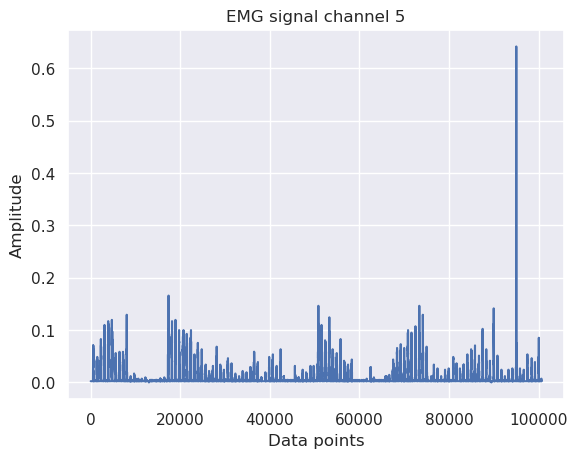

In [7]:
# Plot first channel to get a sense of the data
plt.close("all")
fig, ax = plt.subplots()

EMG_channel = 5

start = 20000
end = 30000

# ax.plot(emg[start:end, EMG_channel])
ax.plot(emg[:, EMG_channel])   
ax.set_title(f"EMG signal channel {EMG_channel}")
ax.set_xlabel("Data points")
ax.set_ylabel("Amplitude")

### Envelop exctraction by applying a moving average

In [8]:
stimulus = data['restimulus']
repetition = data['rerepetition']

print(f'Shape of the data: \nEMG: {emg.shape}, \nStimulus: {stimulus.shape}, \nRepetition: {repetition.shape}')

Shape of the data: 
EMG: (100686, 10), 
Stimulus: (100686, 1), 
Repetition: (100686, 1)


i didn't really get where we can find the value of the sampling frequency

In [9]:
# Sampling frequency (Hz)
fs = 2400 

#Time vector for plotting : create evenly spaced time bins from 0 to the total duration of the signal in s
time_steps = np.arange(0,emg.shape[0]/fs, 1/fs)

mov_mean_size to tune

Text(0.5, 0.98, 'EMG envelopes')

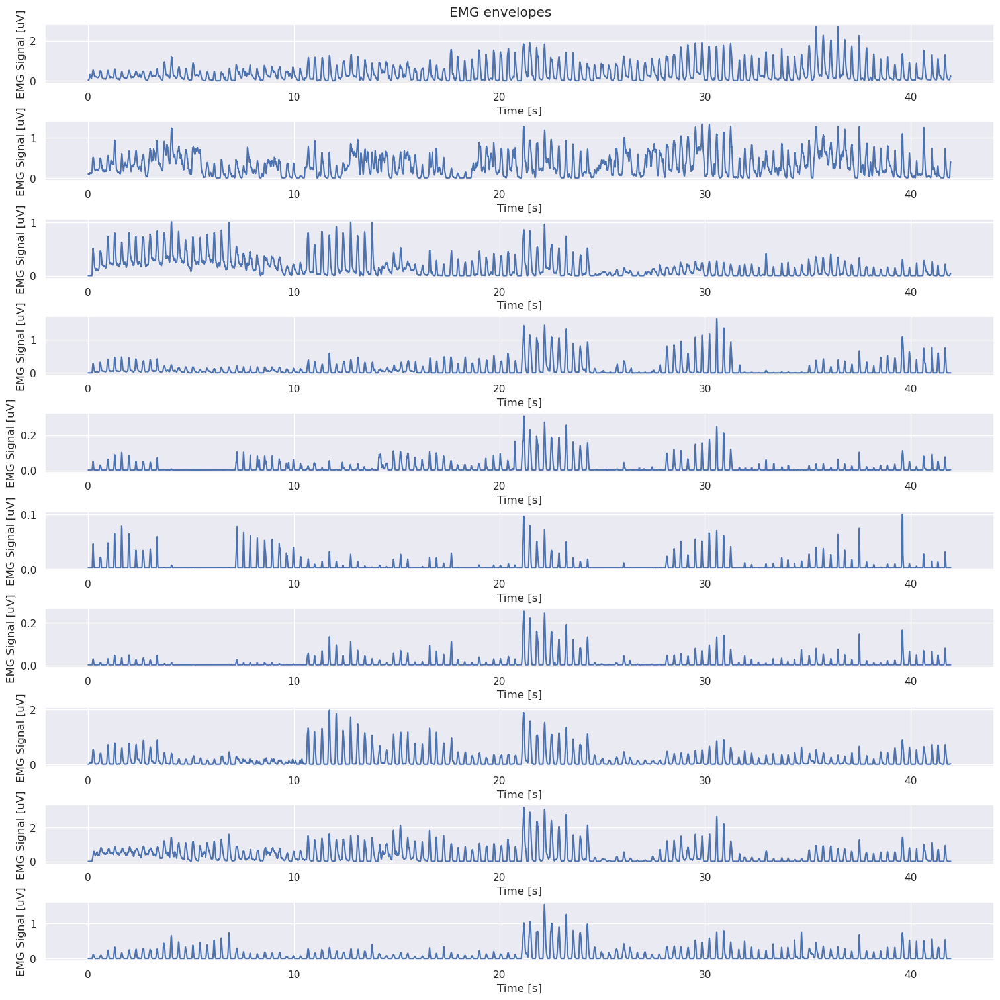

In [10]:
mov_mean_size = 100
mov_mean_weights = np.ones(mov_mean_size) / mov_mean_size
emg_envelopes = convolve1d(emg, weights=mov_mean_weights, axis=0) # convolve1d the rectified signal with the moving average weights


fig, ax = plt.subplots(n_channels, 1, constrained_layout=True, figsize=(15, 15))
for channel_idx in range(n_channels):
    ax[channel_idx].plot(time_steps, emg_envelopes[:, channel_idx])
    ax[channel_idx].set_xlabel("Time [s]")
    ax[channel_idx].set_ylabel("EMG Signal [uV]")
plt.suptitle("EMG envelopes")

In [11]:
# -1 because 0 is the resting condition
n_stimuli = len(np.unique(stimulus)) - 1 
# -1 because 0 is not a repetition
n_repetitions = len(np.unique(repetition)) - 1 

print(f'How many types of movement are there? {n_stimuli}') 
print(f'How many repetitions are there? {n_repetitions}') 

How many types of movement are there? 12
How many repetitions are there? 10


In [12]:
number_of_samples_per_trial = np.zeros((n_stimuli, n_repetitions))

for stimuli_idx in range(n_stimuli):
    for repetition_idx in range(n_repetitions):
        
        idx = np.logical_and(stimulus == stimuli_idx+1, repetition == repetition_idx+1)
        number_of_samples_per_trial[stimuli_idx, repetition_idx] = np.sum(idx.astype(int))

number_of_samples_per_trial.shape
number_of_samples_per_trial

array([[307., 390., 262., 226., 418., 204., 196., 270., 306., 489.],
       [334., 323., 344., 309., 333., 376., 362., 307., 348., 339.],
       [465., 352., 450., 460., 436., 389., 323., 388., 383., 316.],
       [310., 402., 357., 396., 255., 333., 263., 369., 438., 471.],
       [516., 382., 425., 379., 463., 411., 387., 343., 286., 377.],
       [337., 319., 337., 368., 338., 336., 268., 354., 319., 313.],
       [428., 392., 341., 393., 421., 445., 342., 328., 329., 358.],
       [289., 372., 406., 397., 498., 336., 415., 328., 472., 405.],
       [384., 424., 371., 316., 280., 314., 342., 284., 307., 421.],
       [311., 296., 299., 296., 301., 246., 213., 317., 493., 221.],
       [352., 403., 338., 416., 330., 355., 313., 322., 329., 219.],
       [270., 330., 300., 387., 295., 204., 363., 267., 281., 329.]])

### Visualization of the data for one single trial

In [13]:
#defining the length of the moving average window
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

#initializing the data structure
emg_windows = [[None for repetition_idx in range(n_repetitions)] for stimuli_idx in range(n_stimuli)]
emg_envelopes = [[None for repetition_idx in range(n_repetitions)] for stimuli_idx in range(n_stimuli)]

for stimuli_idx in range(n_stimuli):
    for repetition_idx in range(n_repetitions):
        idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1).flatten()
        emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
        emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0) 

Text(0.5, 0.98, 'Envelopes of the EMG signal')

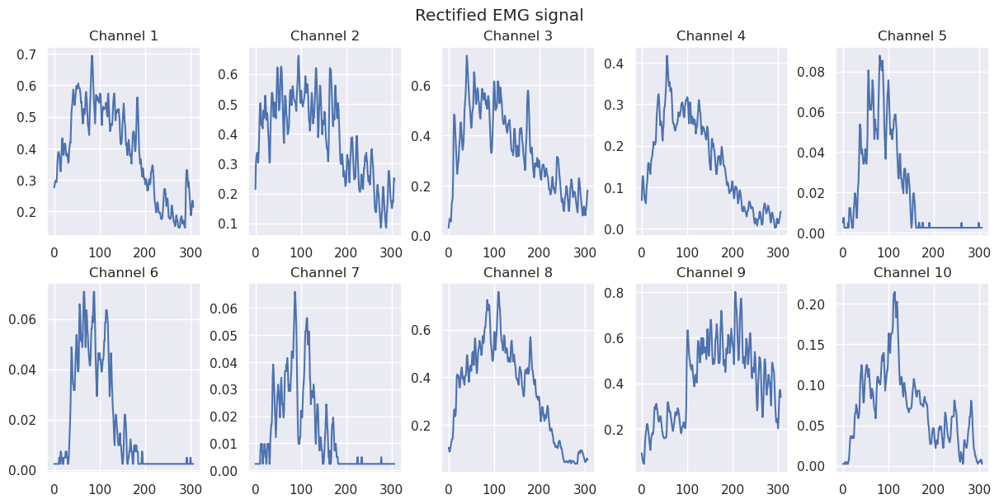

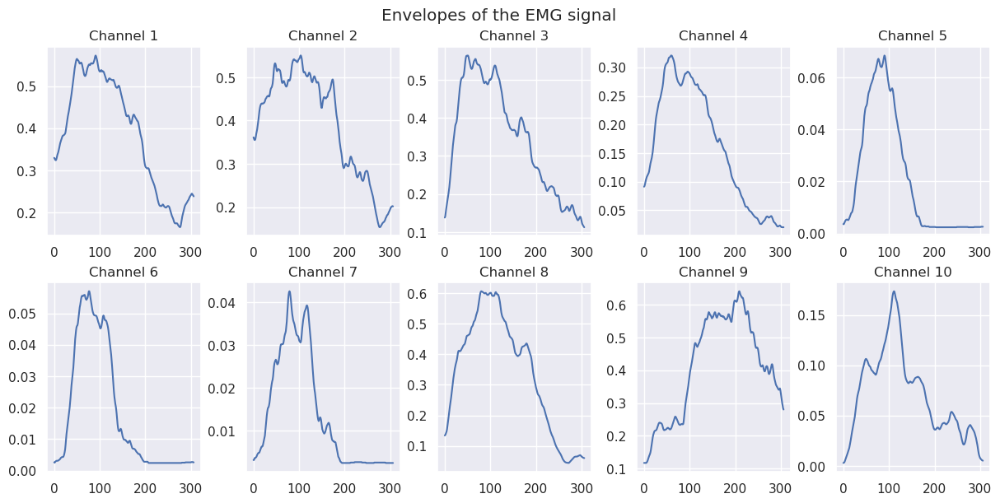

In [14]:
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True)
ax = ax.ravel()

trial = emg_windows[6][0]  #Change the indices there to switch between trials  --> first indice : type of movement, second indice : repetition

#10 EMG channels
number_of_emg_channels = emg.shape[-1]
# plot Rectified EMG signal
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_windows[0][0][:, channel_idx])   
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Rectified EMG signal")

# plot Envelopes of the EMG signal
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True)
ax = ax.ravel()
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_envelopes[0][0][:, channel_idx])   
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Envelopes of the EMG signal")

Plotting of the different channels on the same y-scale, to see the importance of each relativ to the other ones

Text(0.5, 0.98, 'Envelopes of the EMG signal')

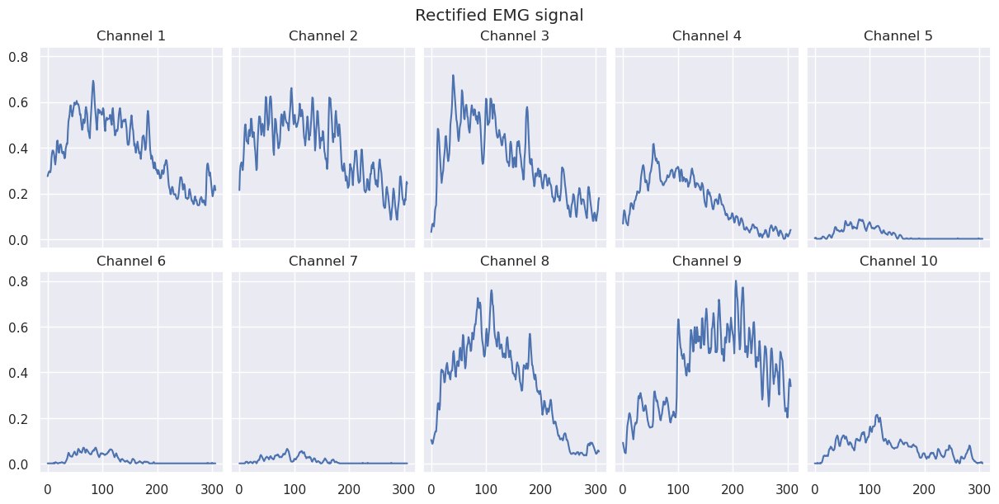

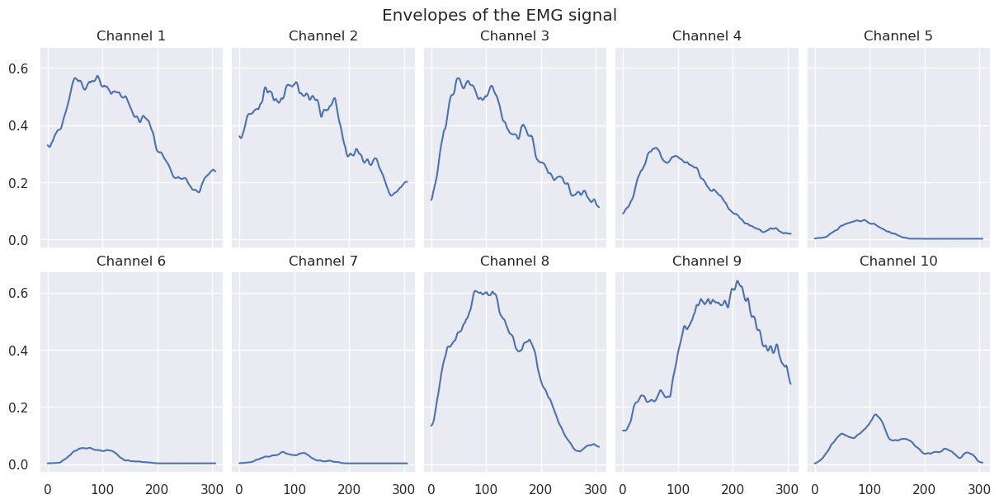

In [15]:
# Now we plot all the channels on the same y-scale
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()

number_of_emg_channels = emg.shape[-1]
# plot Rectified EMG signal
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_windows[0][0][:, channel_idx])   
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Rectified EMG signal")

# plot Envelopes of the EMG signal
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_envelopes[0][0][:, channel_idx])
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Envelopes of the EMG signal")

### Visualizing across repetitions

In [16]:
emg_average_activations = np.zeros((n_channels, n_stimuli, n_repetitions))
for stimuli_idx in range(n_stimuli):
    for repetition_idx in range(n_repetitions):
        #mean across time for each channel
        emg_average_activations[:, stimuli_idx, repetition_idx] = np.mean(emg_envelopes[stimuli_idx][repetition_idx], axis=0) 

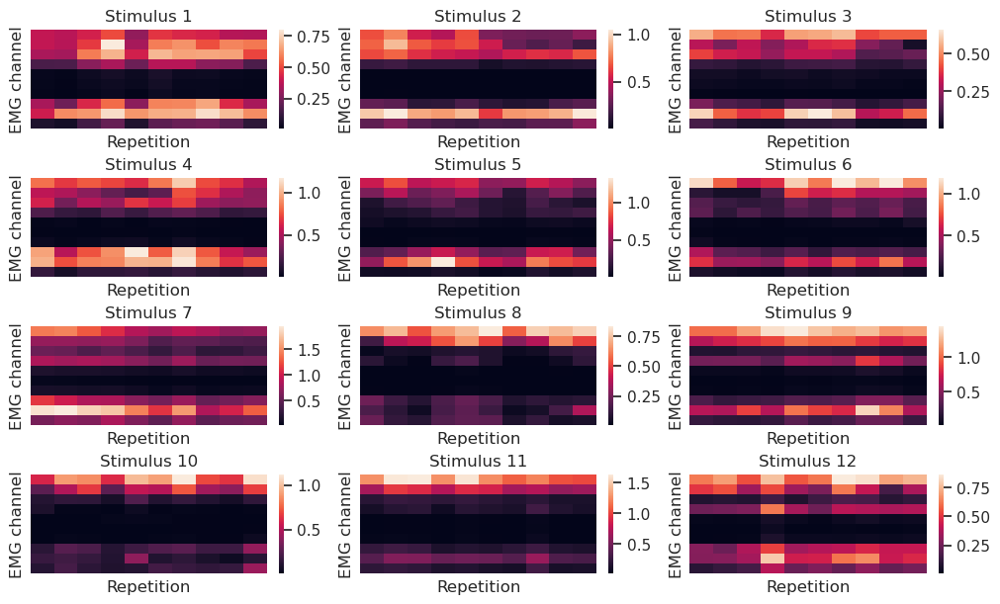

In [17]:
fig, ax = plt.subplots(4, 3, figsize=(10, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()

for stimuli_idx in range(n_stimuli):
    sns.heatmap(np.squeeze(emg_average_activations[:, stimuli_idx, :]), ax=ax[stimuli_idx] ,xticklabels=False, yticklabels=False, cbar = True)
    ax[stimuli_idx].title.set_text("Stimulus " + str(stimuli_idx + 1))
    ax[stimuli_idx].set_xlabel("Repetition")
    ax[stimuli_idx].set_ylabel("EMG channel")

Résultats à analyser: Does the data look reasonable? Did you need to remove any trials?
Channels 5,6 and 7 seem a lot less active than the others

### Extract features and build the dataset for classification 

In [18]:
def build_dataset_from_ninapro(emg, stimulus, repetition, features=None):
    # Calculate the number of unique stimuli and repetitions, subtracting 1 to exclude the resting condition
    n_stimuli = np.unique(stimulus).size - 1
    n_repetitions = np.unique(repetition).size - 1
    # Total number of samples is the product of stimuli and repetitions
    n_samples = n_stimuli * n_repetitions
    
    # Number of channels in the EMG data
    n_channels = emg.shape[1]
    # Calculate the total number of features by summing the number of channels for each feature
    n_features = sum(n_channels for feature in features)
    
    # Initialize the dataset and labels arrays with zeros
    dataset = np.zeros((n_samples, n_features))
    labels = np.zeros(n_samples)
    current_sample_index = 0
    
    # Loop over each stimulus and repetition to extract features
    for i in range(n_stimuli):
        for j in range(n_repetitions):
            # Assign the label for the current sample
            labels[current_sample_index] = i + 1
            # Calculate the current sample index based on stimulus and repetition
            current_sample_index = i * n_repetitions + j
            current_feature_index = 0
            # Select the time steps corresponding to the current stimulus and repetition
            selected_tsteps = np.logical_and(stimulus == i + 1, repetition == j + 1).squeeze()
            
            # Loop over each feature function provided
            for feature in features:
                # Determine the indices in the dataset where the current feature will be stored
                selected_features = np.arange(current_feature_index, current_feature_index + n_channels)
                # Apply the feature function to the selected EMG data and store the result
                dataset[current_sample_index, selected_features] = feature(emg[selected_tsteps, :])
                # Update the feature index for the next feature
                current_feature_index += n_channels

            # Move to the next sample
            current_sample_index += 1
            
    # Return the constructed dataset and corresponding labels
    return dataset, labels

In [19]:
# Define the features 

# Mean absolute value (MAV)
mav = lambda x: np.mean(np.abs(x), axis=0)
# Standard Deviation (STD)
std = lambda x: np.std(x, axis=0)
# Maximum absolute Value (MaxAV)
maxav = lambda x: np.max(np.abs(x), axis=0)
# Root mean square (RMS)
rms = lambda x: np.sqrt(np.mean(x**2, axis=0))
# Waveform length (WL)
wl = lambda x: np.sum(np.abs(np.diff(x, axis=0)), axis=0)
# Slope sign changes (SSC)
ssc = lambda x: np.sum((np.diff(x, axis=0)[:-1, :] * np.diff(x, axis=0)[1:, :]) < 0, axis=0)

#Feel free to add more features, e.g. frequency domain features. (See https://doi.org/10.3390/s19204596 and https://doi.org/10.1088/0967-3334/24/2/307)


dataset, labels = build_dataset_from_ninapro(
    emg=emg,
    stimulus=stimulus,
    repetition=repetition,
    #features=[mav, std]
    features=[mav, std, maxav, rms, wl, ssc] # Uncomment this line to use all features once implemented
)

print(f"dataset dimension: {dataset.shape}")
print(f"labels dimension: {labels.shape}")

dataset dimension: (120, 60)
labels dimension: (120,)


Now that we have created the dataset, we need to split it into training, validation and testing data.

Accuracy score: 0.8620689655172413


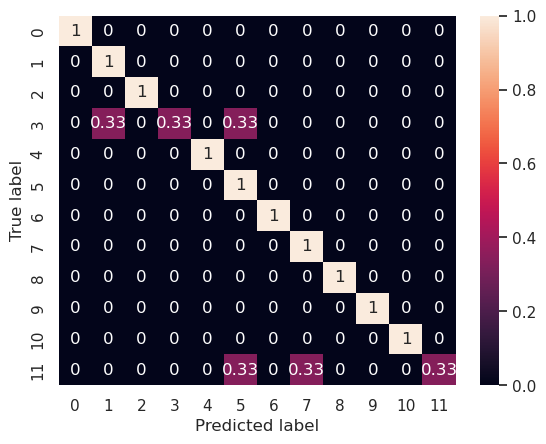

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Split the dataset into training and testing sets
# Here, 30% of the data is reserved for testing, and 70% is used for training
X_train, X_test, y_train, y_test = train_test_split(dataset, labels, test_size=0.2)

# The training set now needs be further split into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3)

# Normalizing the data
# StandardScaler is used to scale the features so that they have a mean of 0 and a standard deviation of 1
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train_z = scaler.fit_transform(X_train)  # Fit the scaler on the training data and transform it
X_val_z = scaler.transform(X_val)        # Transform the test data using the same scaler
X_test_z = scaler.transform(X_test)


clf = RandomForestClassifier()
clf.fit(X_train_z, y_train)

# Evaluate the classifier on the test set
# Predict the labels for the test set
y_pred = clf.predict(X_val_z)
# Calculate the accuracy of the model
accuracy = accuracy_score(y_val, y_pred)
print(f"Accuracy score: {accuracy}")

# Create a confusion matrix to visualize the performance of the classification
# The confusion matrix shows the true vs predicted labels
confmat = confusion_matrix(y_val, y_pred, normalize="true")
fig, ax = plt.subplots()
sns.heatmap(confmat, annot=True, ax=ax)  # Use seaborn to create a heatmap of the confusion matrix
ax.set_ylabel("True label")
ax.set_xlabel("Predicted label");

lets do some cross-validation!

In [21]:
# perform cross-validation
from sklearn.model_selection import cross_val_score
scores = cross_val_score(clf, X_train_z, y_train, cv=5)
print(f"Accuracy scores of all models: {scores}")
print(f"Mean accuracy across all models: {np.mean(scores)}")

/opt/conda/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Accuracy scores of all models: [0.92857143 0.85714286 0.53846154 0.76923077 0.76923077]
Mean accuracy across all models: 0.7725274725274724


Hyperparameter optimization seems like a good idea as well

In [22]:
# use cross validation to find the best hyperparameters for SVC

from sklearn.model_selection import GridSearchCV

param_grid = {
    "n_estimators": [90,100,110,120,130],
    "max_features": ['sqrt', 'log2'],
}

grid = GridSearchCV(RandomForestClassifier(), param_grid)
grid.fit(X_train_z, y_train)

print(f"Best estimator: {grid.best_estimator_}")
print(f"Best hyperparameters: {grid.best_params_}")

y_pred = grid.predict(X_val_z)

accuracy = accuracy_score(y_val, y_pred)
print(f"Accuracy score of best model: {accuracy}")

/opt/conda/lib/python3.11/site-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


Best estimator: RandomForestClassifier(n_estimators=120)
Best hyperparameters: {'max_features': 'sqrt', 'n_estimators': 120}
Accuracy score of best model: 0.8275862068965517


### Feature Selection / Dimensionality Reduction

Estimated mutual information between each feature and the target:
 [7.14214953e-01 3.82221544e-01 8.11131054e-01 7.99889343e-01
 8.46660857e-01 5.69611640e-01 5.82399557e-01 7.50872635e-01
 7.04340145e-01 5.62992547e-01 7.66460244e-01 1.80316265e-01
 7.27098880e-01 9.28571826e-01 7.03125551e-01 6.30201153e-01
 5.97601686e-01 5.96772832e-01 6.56455420e-01 5.36532904e-01
 7.22629765e-01 3.03347709e-01 6.65329363e-01 8.18232892e-01
 5.62812468e-01 6.68122141e-01 5.12319749e-01 5.62714568e-01
 7.32079038e-01 5.39314528e-01 8.17566800e-01 3.65465207e-01
 8.42541298e-01 8.50377595e-01 7.52394896e-01 6.08588202e-01
 6.34980605e-01 7.46580062e-01 7.75062029e-01 5.19448370e-01
 4.12688916e-01 1.96014810e-01 8.92998249e-01 7.95356940e-01
 8.65313407e-01 6.51621158e-01 6.40735836e-01 5.51644638e-01
 6.18206741e-01 6.47095746e-01 1.01670108e-01 8.98078966e-04
 8.87025227e-02 2.86378884e-01 5.19515796e-01 3.91499756e-01
 5.30046312e-01 1.43393026e-01 2.28071755e-01 9.58928313e-02]

Accuracy score o

Text(0.5, 19.049999999999997, 'Predicted label')

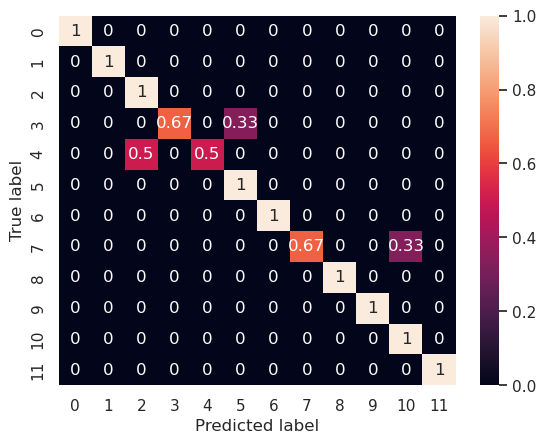

In [23]:
# Import necessary functions for feature selection
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest

# Calculate mutual information between each feature and the target variable.
# Mutual information is a measure of the dependency between variables.
# A higher value indicates a stronger relationship.
mutual_info = mutual_info_classif(X_train_z, y_train)
print(f"Estimated mutual information between each feature and the target:\n {mutual_info}\n")

# Select the top 10 features based on mutual information scores.
# Note: You can change 'k' to 30 if you are working with more features.
k_best = SelectKBest(mutual_info_classif, k=10)
k_best.fit(X_train_z, y_train)

# Transform the training and test datasets to only include the selected features.
X_train_best = k_best.transform(X_train_z)
X_val_best = k_best.transform(X_val_z)

clf = RandomForestClassifier(**grid.best_params_) # use the best parameters found before, You can also perform another round of grid search with the new features
clf.fit(X_train_best, y_train)

# Predict the labels for the test set using the trained model.
y_pred = clf.predict(X_val_best)

# Calculate the accuracy of the model with the selected features.
# Accuracy is the ratio of correctly predicted instances to the total instances.
accuracy = accuracy_score(y_val, y_pred)
print(f"Accuracy score of a model with k best features: {accuracy}")

# Create a confusion matrix to visualize the performance of the classification model.
# The confusion matrix shows the true vs predicted labels.
confmat = confusion_matrix(y_val, y_pred, normalize="true")

# Plot the confusion matrix using a heatmap for better visualization.
fig, ax = plt.subplots()
sns.heatmap(confmat, annot=True, ax=ax)
ax.set_ylabel("True label")
ax.set_xlabel("Predicted label")

# Part 2
## Visualization and Preprocessing of the Data with the 27 Subjects

#### Downloading of Data

In [31]:
import os
from scipy.io import loadmat

# Loop over subjects 1 to 27
for subject in range(1, 28):
    # Construct the path for each subject
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    # Check if the file exists before trying to load it
    if os.path.exists(data_path):
        data = loadmat(data_path)
        print(f"\nDataset variables for Subject {subject}:")
        
        # Iterate through the keys of the loaded data and print the relevant ones
        for key in data.keys():
            if not key.startswith("__"):
                print(f"  {key}")
        
        # Extract EMG data
        emg = data["emg"]
        print(f"EMG data for Subject {subject}:")

        # Print the EMG data dimension and type
        print("EMG data dimension: {}".format(emg.shape))
        print("EMG data type: {}".format(type(emg)))
        
        # Get the shape information for EMG
        data_shape = emg.shape
        n_timepoints = emg.shape[0]
        n_channels = emg.shape[1]

        # Print the shape and other details
        print(f'The shape of the EMG data is {data_shape}')
        print(f'There are {n_timepoints} timepoints')
        print(f'There are {n_channels} channels\n')
        
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")



Dataset variables for Subject 1:
  emg
  stimulus
  glove
  subject
  exercise
  repetition
  restimulus
  rerepetition
EMG data for Subject 1:
EMG data dimension: (101014, 10)
EMG data type: <class 'numpy.ndarray'>
The shape of the EMG data is (101014, 10)
There are 101014 timepoints
There are 10 channels


Dataset variables for Subject 2:
  subject
  exercise
  stimulus
  emg
  glove
  restimulus
  repetition
  rerepetition
EMG data for Subject 2:
EMG data dimension: (100686, 10)
EMG data type: <class 'numpy.ndarray'>
The shape of the EMG data is (100686, 10)
There are 100686 timepoints
There are 10 channels


Dataset variables for Subject 3:
  subject
  exercise
  stimulus
  emg
  glove
  restimulus
  repetition
  rerepetition
EMG data for Subject 3:
EMG data dimension: (100720, 10)
EMG data type: <class 'numpy.ndarray'>
The shape of the EMG data is (100720, 10)
There are 100720 timepoints
There are 10 channels


Dataset variables for Subject 4:
  subject
  exercise
  stimulus
  em

## Preprocessing of the Data 

As in part 1, the data are partially preprocessed, i.e. already amplified, bandpass-filtered and RMS rectified. The signals were also cleaned  from 50 Hz (and harmonics) power-line interference using a Hampel filter. 

### Visualization of the EMG Signal on One Channel

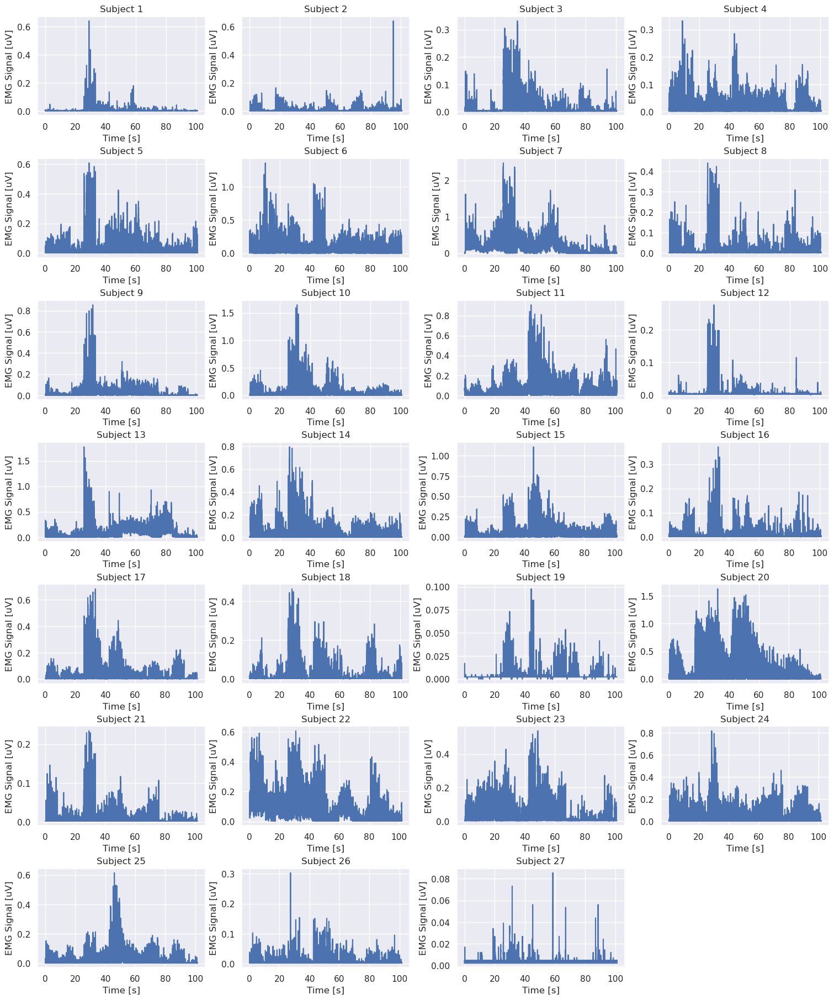

In [46]:
import os
import matplotlib.pyplot as plt
from scipy.io import loadmat
import numpy as np

# Loop over subjects 1 to 27
fig, axes = plt.subplots(7, 4, figsize=(15, 18), constrained_layout=True)  # 7 rows, 4 columns
axes = axes.flatten()  # Flatten to easily index axes

# Assuming fs (sampling frequency) is known, for example:
fs = 1000  # 1000 Hz (samples per second)

# Loop through each subject and plot one channel
for subject in range(1, 28):
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        data = loadmat(data_path)
        emg = data["emg"]
        
        # Specify the channel you want to visualize (for example, channel 5)
        EMG_channel = 5
        
        # Time vector for plotting (create evenly spaced time bins from 0 to the total duration of the signal in s)
        time_steps = np.arange(0, emg.shape[0] / fs, 1 / fs)

        # Get the corresponding axis for this subject
        ax = axes[subject - 1]  # axes are zero-indexed, so we subtract 1
        
        # Plot the selected channel for this subject
        ax.plot(time_steps, emg[:, EMG_channel])
        ax.set_title(f"Subject {subject}")
        ax.set_xlabel("Time [s]")
        ax.set_ylabel("EMG Signal [uV]")
        
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")

# Hide any unused subplots (for example, the last subplot if you use a 7x4 grid for 27 subjects)
for i in range(27, 28):  # 28 total plots, 27 used
    axes[i].axis('off')  # Hide the remaining unused axes

# Show the plot
plt.show()


### Envelop Extraction by Applying a Moving Average

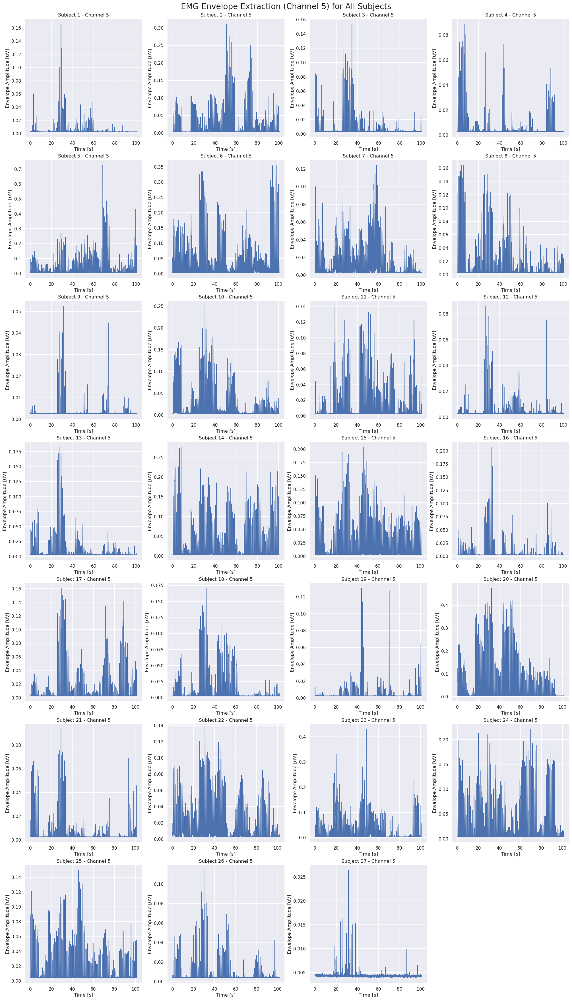

In [61]:
#4 plots per lines but not really useful to see fully the envelop
'''
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from scipy.ndimage import convolve1d
import os

# Sampling frequency (Hz)
fs = 1000  # Update as needed for your data

# Moving average size for envelope extraction (window size in samples)
mov_mean_size = 100  # You can adjust this value for more or less smoothing
mov_mean_weights = np.ones(mov_mean_size) / mov_mean_size

# Set number of plots per row (4 plots per row)
n_cols = 4
n_rows = (27 // n_cols) + (27 % n_cols > 0)  # Calculate rows based on the number of subjects (27)

# Create a large figure with a grid layout (4 columns per row)
fig, ax = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows), constrained_layout=True)

# Flatten the axes array for easier indexing (since it's 2D)
ax = ax.flatten()

# Loop over subjects 1 to 27
for subject in range(1, 28):
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"  # Path to subject's data
    
    if os.path.exists(data_path):
        # Load the data for each subject
        data = loadmat(data_path)
        emg = data["emg"]
        
        # Time vector for plotting (create evenly spaced time bins from 0 to the total duration of the signal in s)
        time_steps = np.arange(0, emg.shape[0] / fs, 1 / fs)
        
        # Select the 5th channel (index 4)
        channel_idx = 4
        emg_channel = emg[:, channel_idx]
        
        # Step 1: Rectify the EMG signal (take absolute value)
        emg_rectified = np.abs(emg_channel)
        
        # Step 2: Apply moving average (convolution) to the rectified EMG signal (envelope extraction)
        emg_envelope = convolve1d(emg_rectified, weights=mov_mean_weights, axis=0)
        
        # Plot the envelope of the 5th channel in the current subplot
        ax[subject - 1].plot(time_steps, emg_envelope)
        ax[subject - 1].set_xlabel("Time [s]")
        ax[subject - 1].set_ylabel("Envelope Amplitude [uV]")
        ax[subject - 1].set_title(f"Subject {subject} - Channel 5")
    
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")

# Hide any unused subplots (in case of non-divisible number of subjects)
for i in range(27, len(ax)):
    ax[i].axis('off')

# Show the grid of plots
plt.suptitle("EMG Envelope Extraction (Channel 5) for All Subjects", fontsize=20)
plt.show()
'''


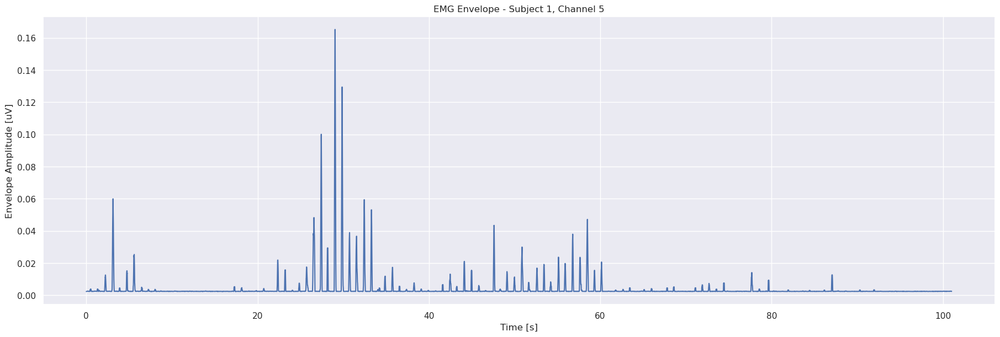

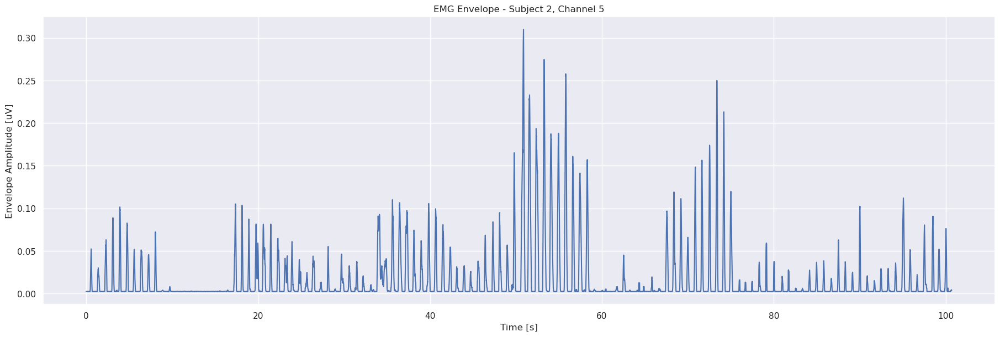

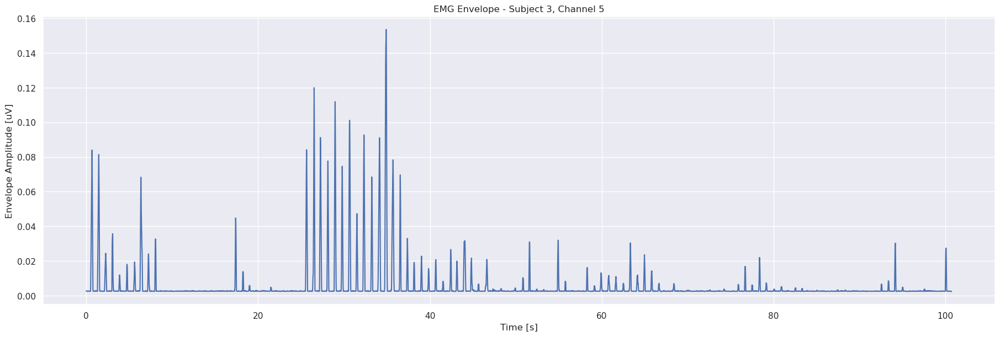

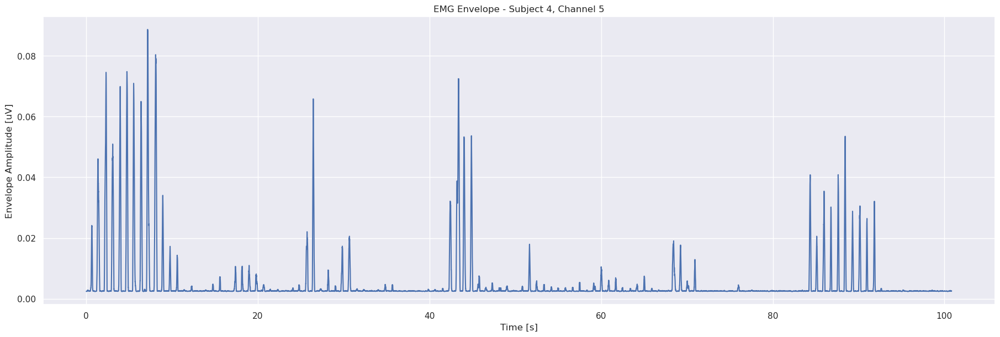

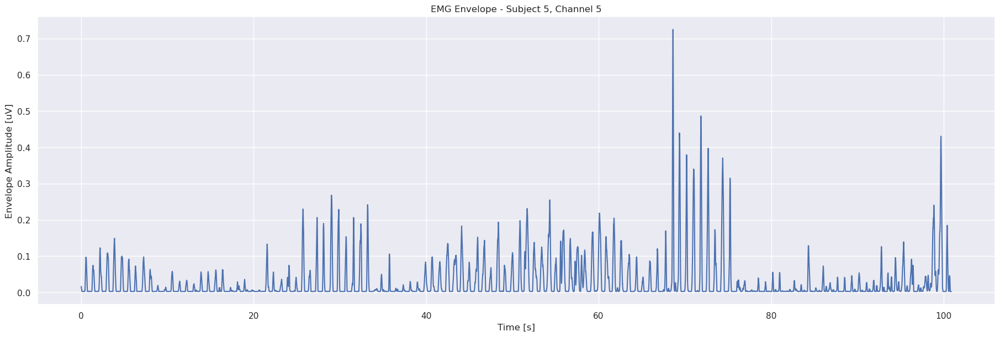

...

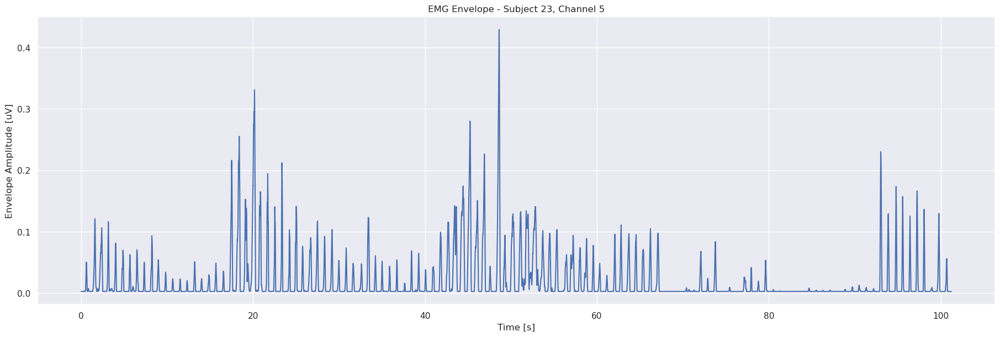

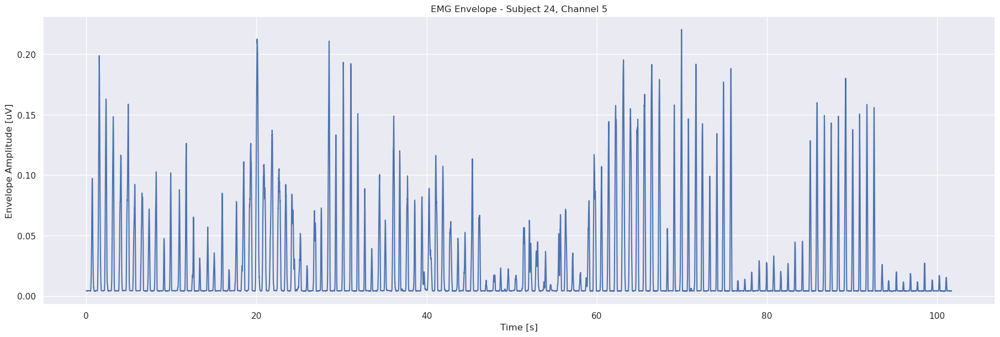

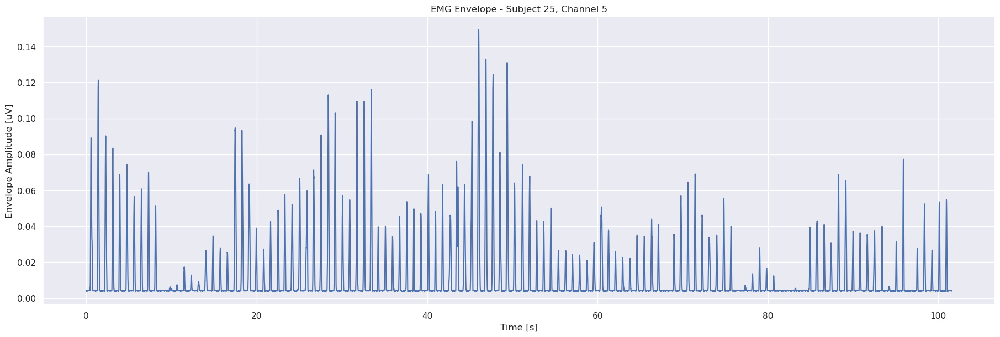

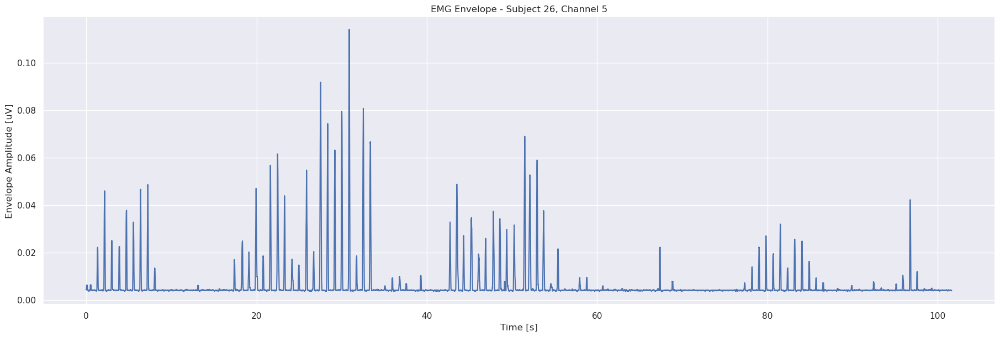

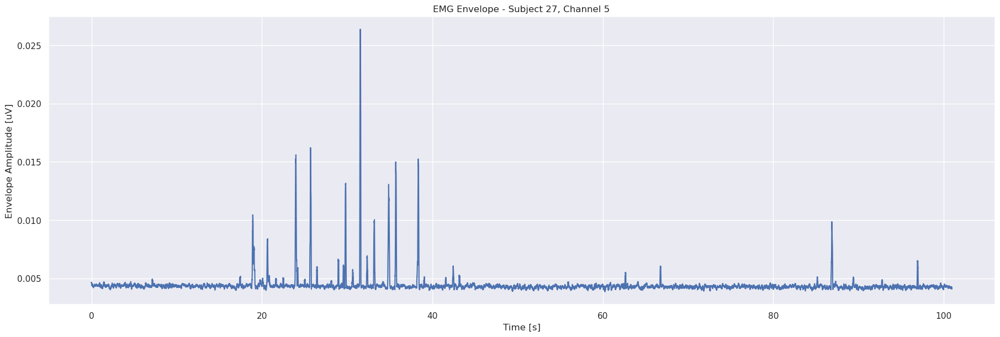

In [57]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from scipy.ndimage import convolve1d
import os

# Sampling frequency (Hz)
fs = 1000  # Update as needed for your data

# Moving average size for envelope extraction (window size in samples)
mov_mean_size = 100  # You can adjust this value for more or less smoothing
mov_mean_weights = np.ones(mov_mean_size) / mov_mean_size

# Loop over subjects 1 to 27
for subject in range(1, 28):
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"  # Path to subject's data
    
    if os.path.exists(data_path):
        # Load the data for each subject
        data = loadmat(data_path)
        emg = data["emg"]
        
        # Time vector for plotting (create evenly spaced time bins from 0 to the total duration of the signal in s)
        time_steps = np.arange(0, emg.shape[0] / fs, 1 / fs)
        
        # Select the 5th channel (index 4)
        channel_idx = 4
        emg_channel = emg[:, channel_idx]
        
        # Step 1: Rectify the EMG signal (take absolute value)
        emg_rectified = np.abs(emg_channel)
        
        # Step 2: Apply moving average (convolution) to the rectified EMG signal (envelope extraction)
        emg_envelope = convolve1d(emg_rectified, weights=mov_mean_weights, axis=0)
        
        # Create a figure with a single subplot for the envelope
        # Increase figure size to make the plot larger
        fig, ax = plt.subplots(figsize=(18, 6), constrained_layout=True)
        
        # Plot the envelope of the 5th channel
        ax.plot(time_steps, emg_envelope)
        ax.set_xlabel("Time [s]")
        ax.set_ylabel("Envelope Amplitude [uV]")
        ax.set_title(f"EMG Envelope - Subject {subject}, Channel 5")
        
        # Show the plot for the current subject
        plt.show()

    else:
        print(f"File for Subject {subject} does not exist: {data_path}")


### Rectification and Envelope Extraction of EMG Data Across 27 Subjects

In [62]:
import numpy as np
from scipy.io import loadmat
import os

# Number of subjects
n_subjects = 27

# Initialize a list to store the results for each subject
all_number_of_samples_per_trial = []

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        
        # Calculate number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)

        print(f"Subject {subject}:")
        print(f"How many types of movement are there? {n_stimuli}") 
        print(f"How many repetitions are there? {n_repetitions}")
        
        # Initialize array to store the number of samples per trial for this subject
        number_of_samples_per_trial = np.zeros((n_stimuli, n_repetitions))
        
        # Calculate the number of samples per trial for this subject
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the number of samples for the current trial
                number_of_samples_per_trial[stimuli_idx, repetition_idx] = np.sum(idx.astype(int))
        
        # Store the results for this subject
        all_number_of_samples_per_trial.append(number_of_samples_per_trial)
        
        # Print the results for this subject
        print(f"Number of samples per trial (Subject {subject}):\n", number_of_samples_per_trial)
    else:
        print(f"Data file for Subject {subject} not found at {data_path}")
        

Subject 1:
How many types of movement are there? 12
How many repetitions are there? 10
Number of samples per trial (Subject 1):
 [[516. 516. 517. 512. 516. 512. 516. 512. 516. 516.]
 [516. 516. 516. 517. 520. 520. 516. 517. 520. 516.]
 [516. 516. 516. 516. 517. 516. 516. 516. 513. 516.]
 [520. 516. 520. 516. 520. 517. 516. 516. 516. 516.]
 [516. 516. 516. 524. 516. 516. 517. 516. 516. 520.]
 [520. 516. 516. 517. 516. 516. 516. 517. 520. 516.]
 [516. 517. 520. 516. 516. 521. 516. 516. 516. 517.]
 [516. 520. 516. 520. 516. 516. 516. 520. 516. 516.]
 [512. 513. 516. 516. 516. 513. 512. 512. 512. 513.]
 [512. 512. 512. 513. 512. 512. 516. 516. 516. 516.]
 [516. 516. 516. 516. 521. 516. 516. 516. 517. 516.]
 [516. 520. 517. 516. 520. 516. 516. 516. 516. 520.]]
Subject 2:
How many types of movement are there? 12
How many repetitions are there? 10
Number of samples per trial (Subject 2):
 [[512. 512. 512. 512. 512. 512. 512. 512. 512. 512.]
 [516. 517. 516. 516. 516. 516. 516. 520. 516. 520.]

/tmp/ipykernel_478/124034805.py:54: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True)


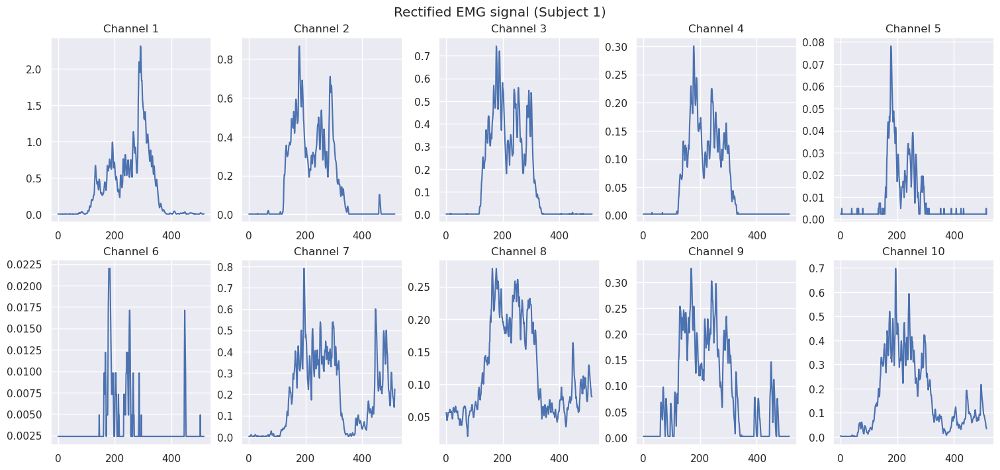

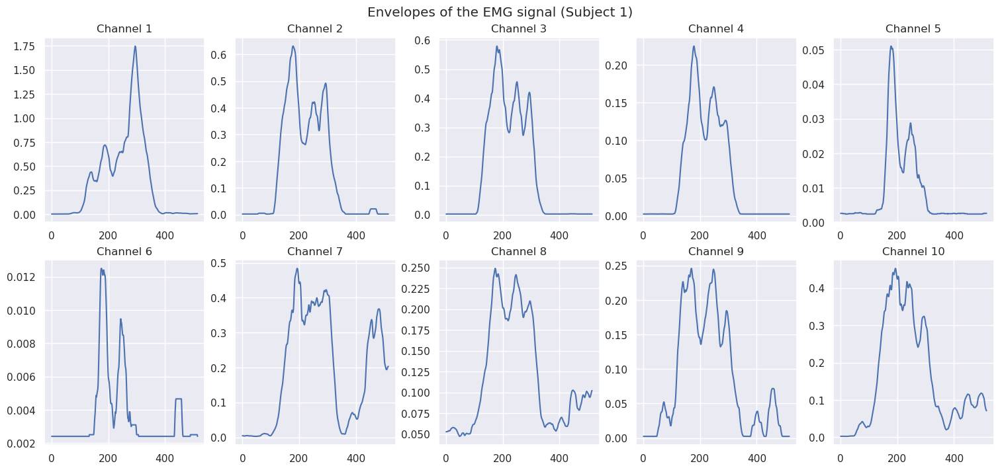

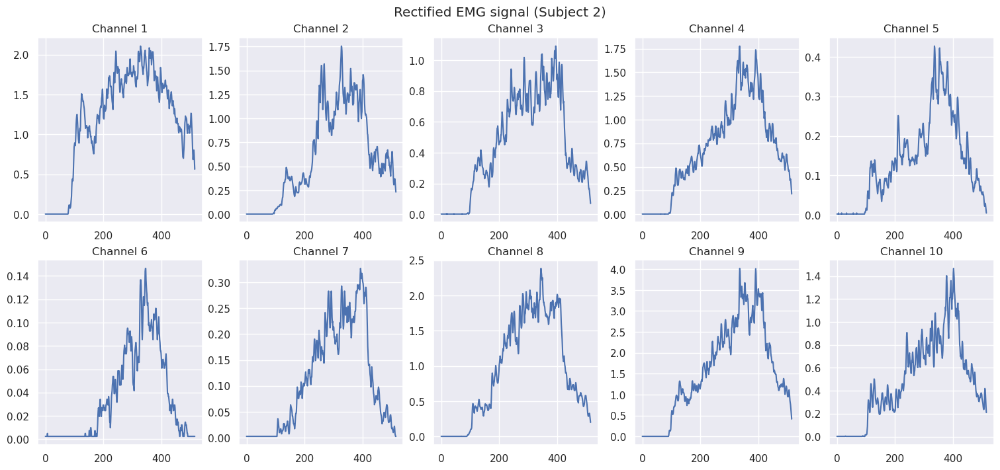

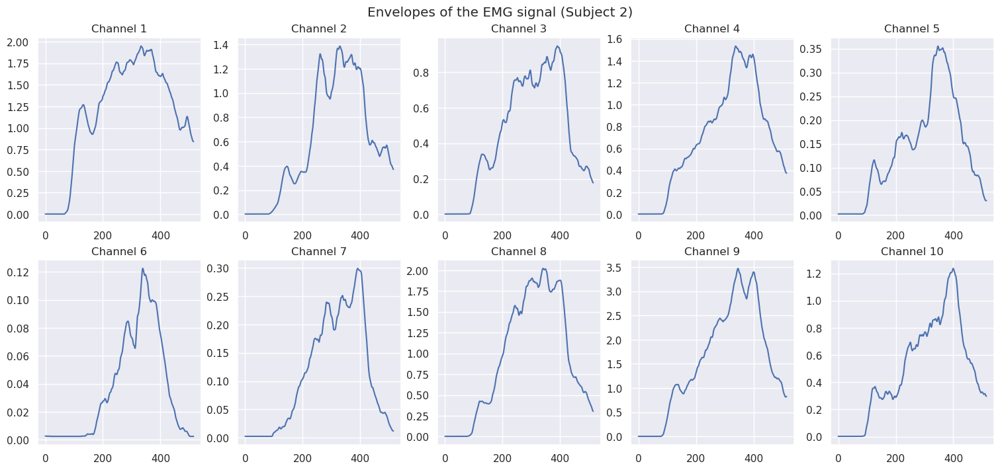

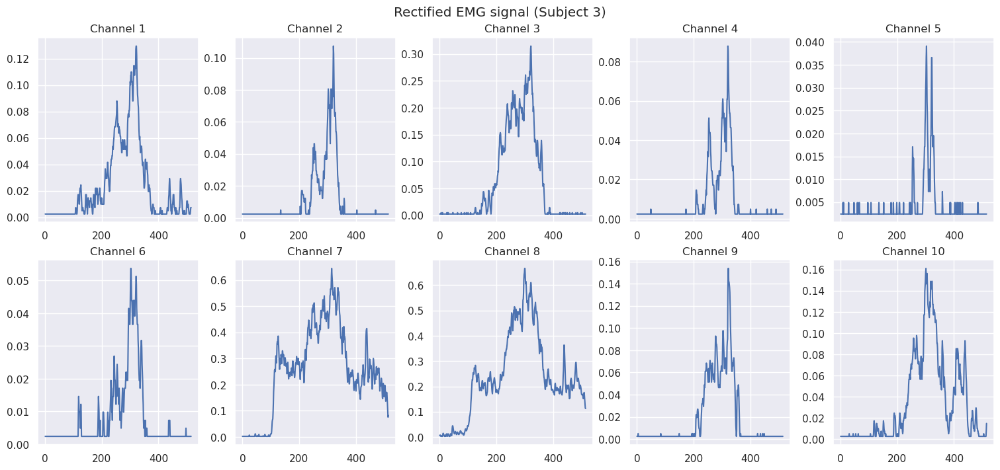

...

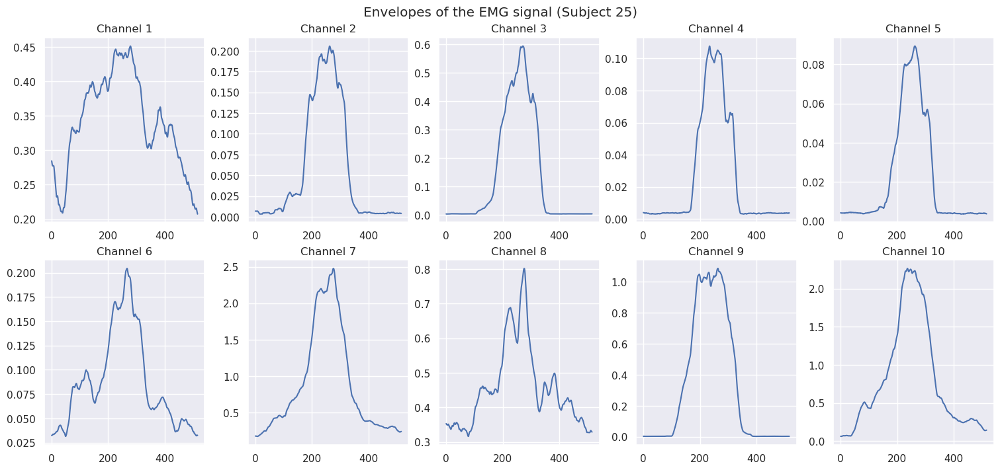

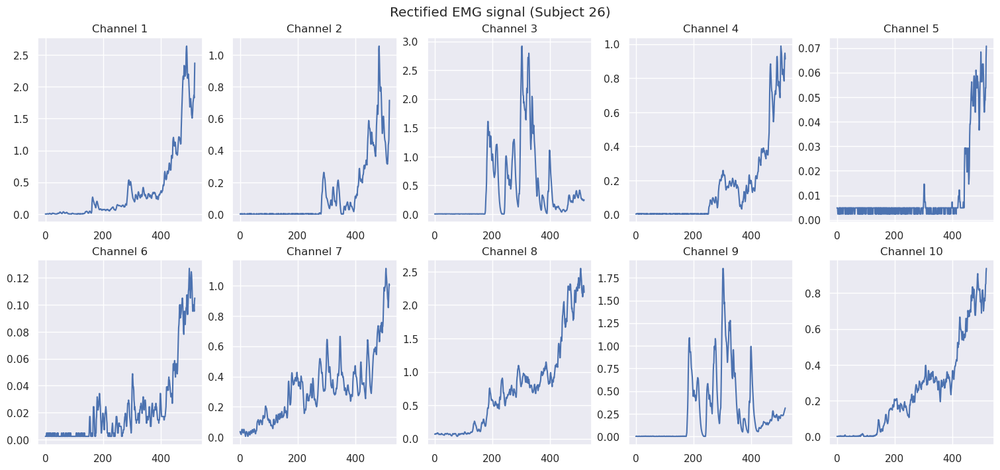

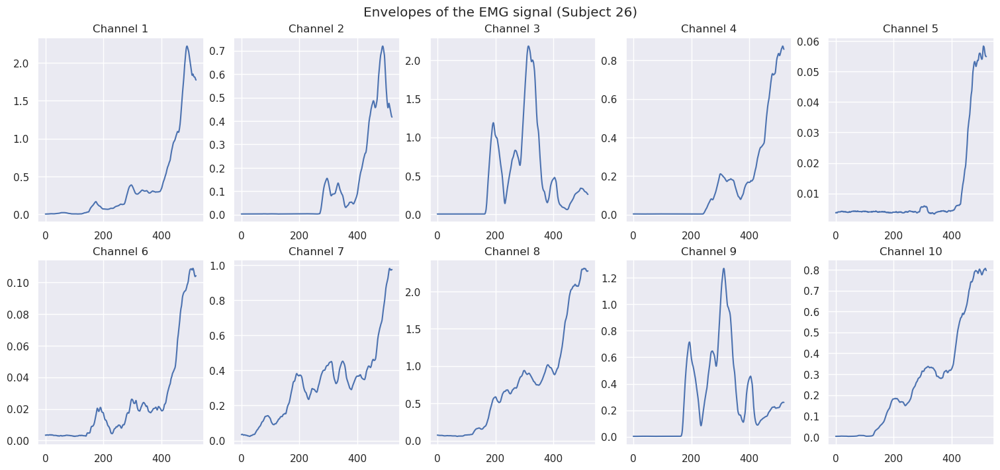

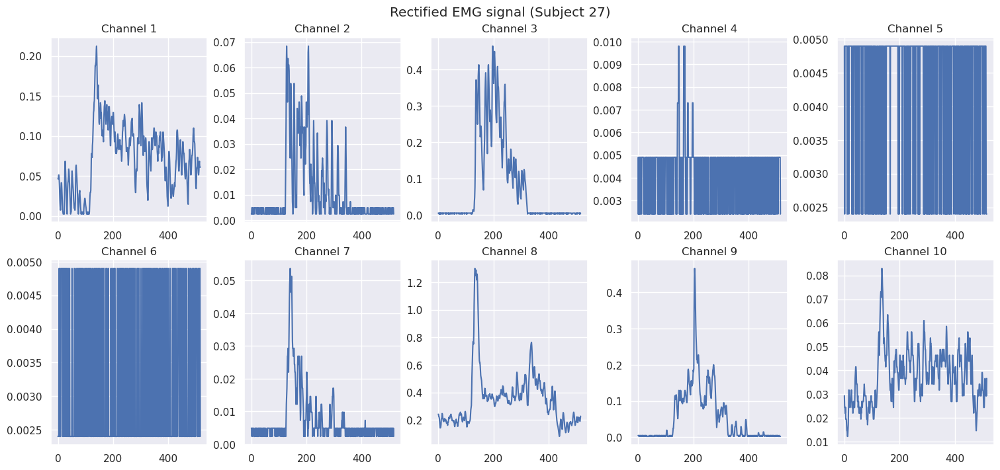

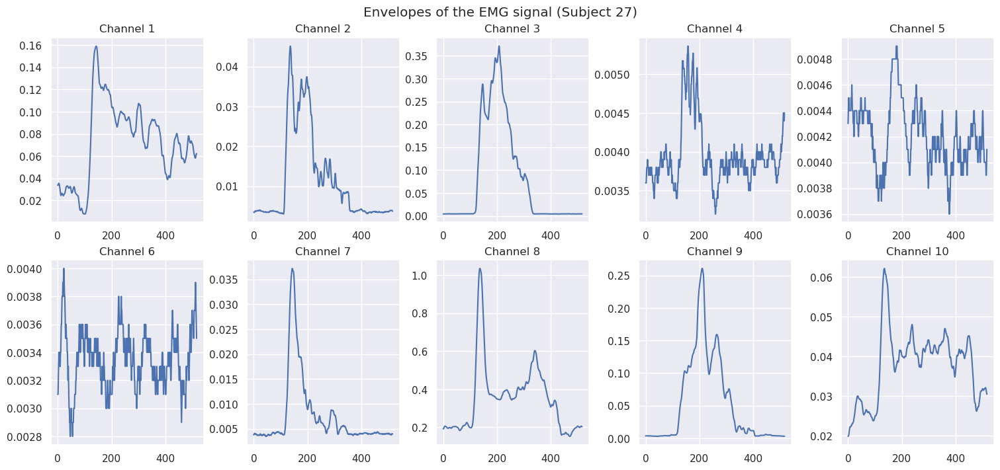

In [66]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve1d

# Number of subjects
n_subjects = 27

# Define moving average window size for envelope extraction
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

# Initialize lists to store the data
all_emg_windows = []
all_emg_envelopes = []

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        emg = data['emg']  # Assuming 'emg' is the name of the EMG data in the file

        # Calculate the number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)
        
        # Initialize arrays to store the EMG windows and envelopes
        emg_windows = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        emg_envelopes = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        
        # Calculate the number of samples per trial and preprocess the EMG signal
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the EMG data window for the current trial
                emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
                # Apply moving average to extract the envelope
                emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0)
        
        # Store the results for this subject
        all_emg_windows.append(emg_windows)
        all_emg_envelopes.append(emg_envelopes)

        # Plotting Rectified EMG and Envelopes for a specific trial (subject, stimuli_idx, repetition_idx)
        trial = emg_windows[6][0]  # Example: Subject 6, first stimulus, first repetition
        
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True)
        ax = ax.ravel()

        # Plot Rectified EMG signals (one for each channel)
        for channel_idx in range(emg.shape[1]):  # Loop through EMG channels
            ax[channel_idx].plot(trial[:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Rectified EMG signal (Subject {subject})")

        # Plot Envelopes of the EMG signal (one for each channel)
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True)
        ax = ax.ravel()
        for channel_idx in range(emg.shape[1]):  # Loop through EMG channels
            ax[channel_idx].plot(emg_envelopes[6][0][:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Envelopes of the EMG signal (Subject {subject})")
    else:
        print(f"Data file for Subject {subject} not found at {data_path}")


All the channels on the same y-scale

/tmp/ipykernel_478/267955415.py:47: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True, sharex=True, sharey=True)


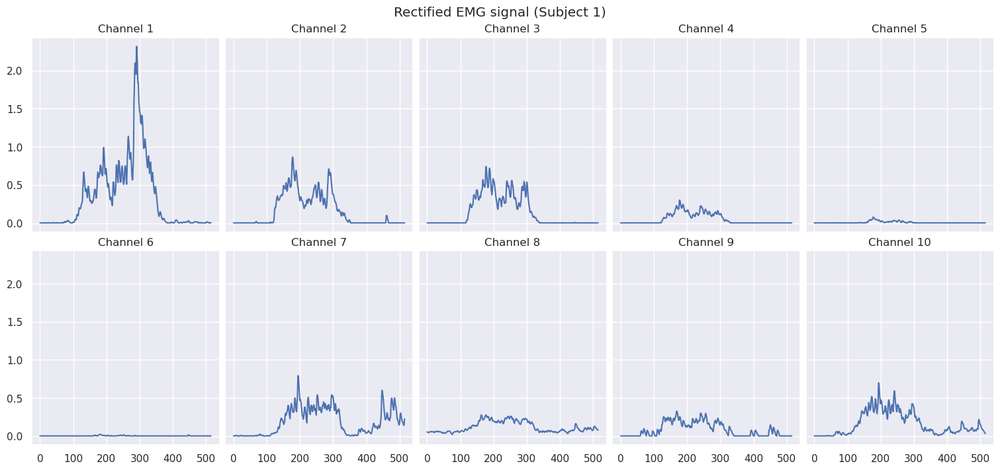

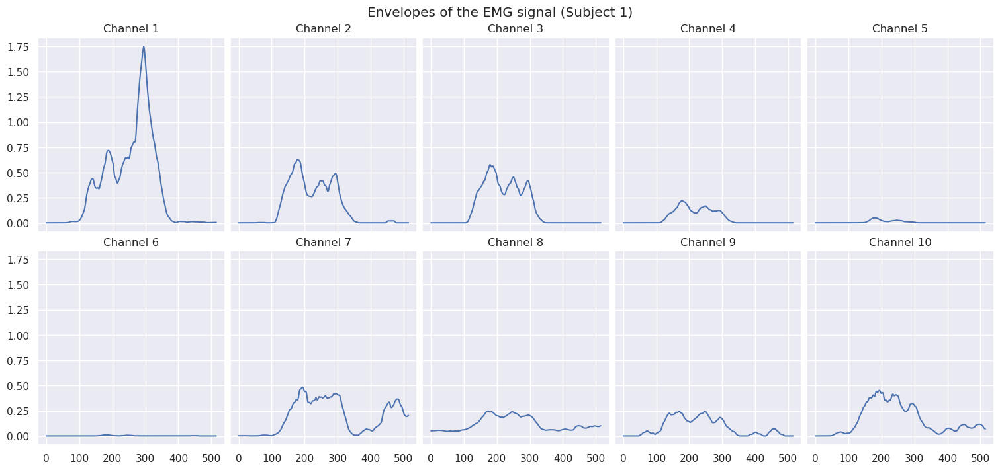

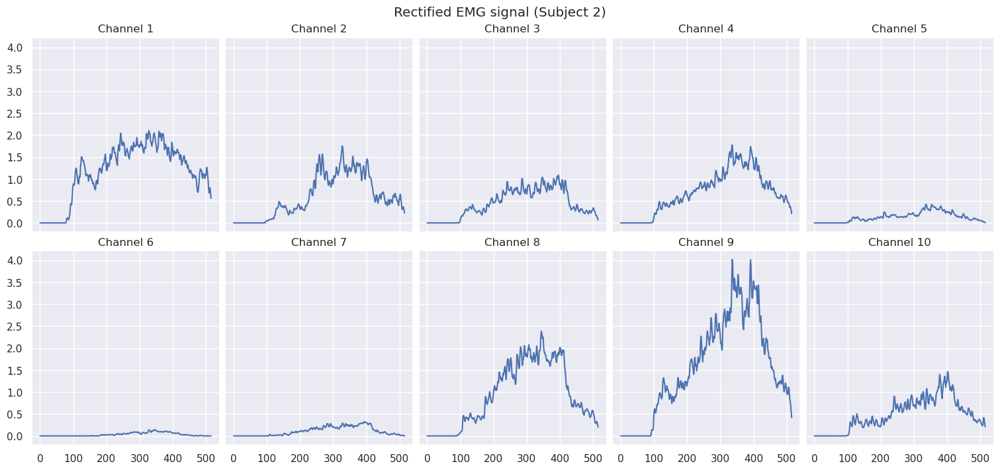

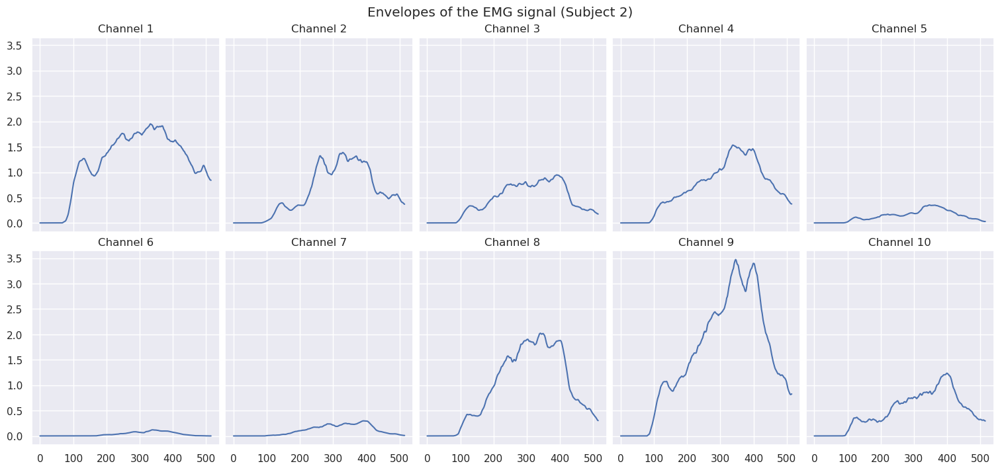

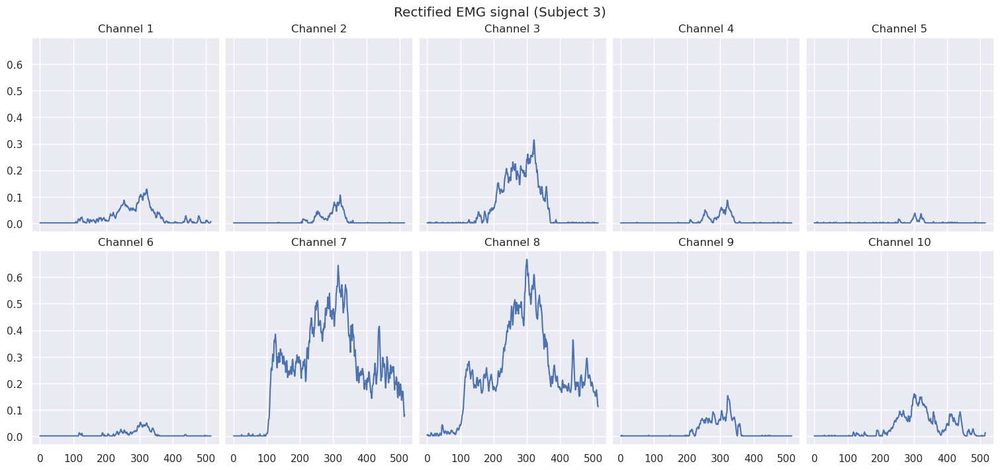

...

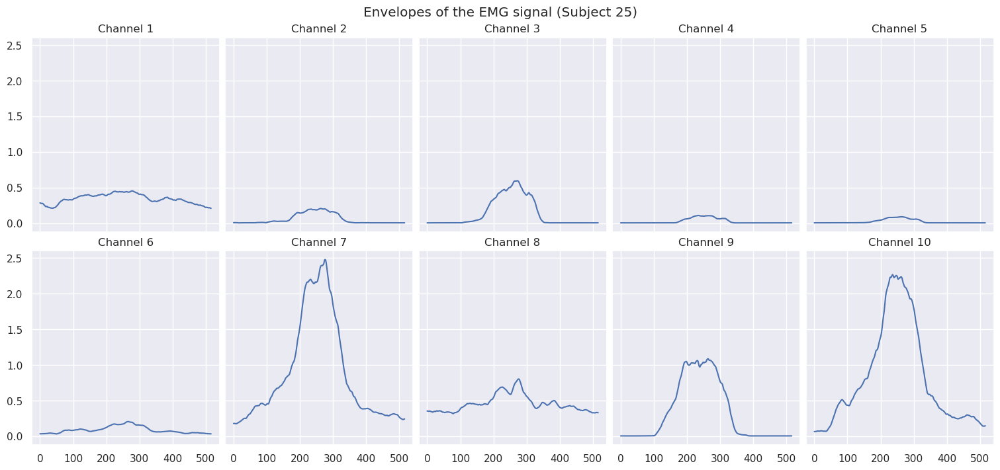

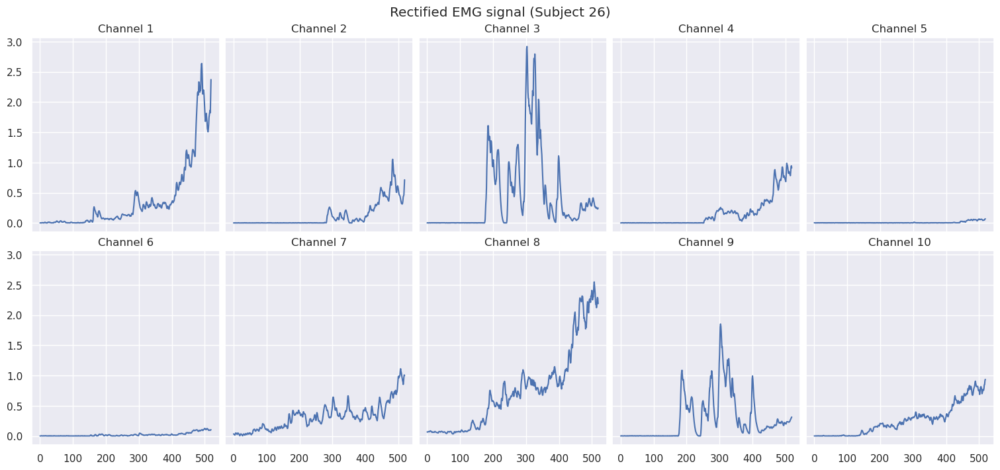

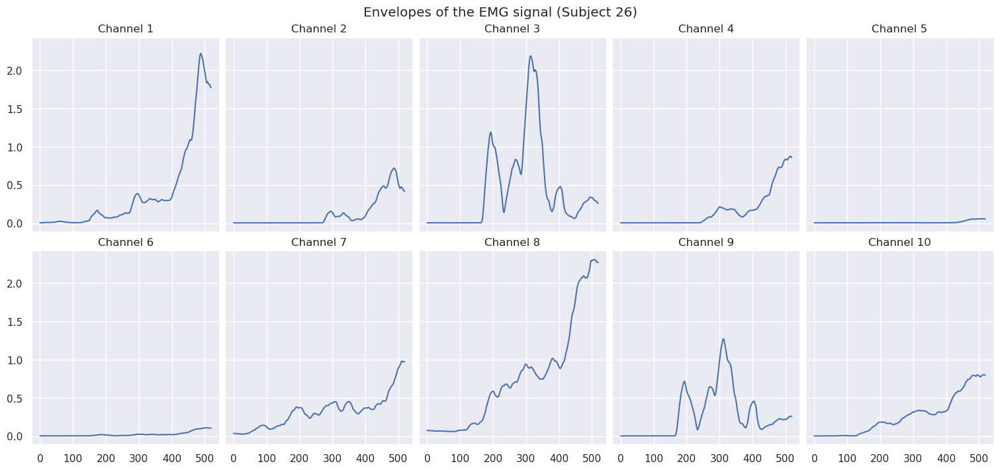

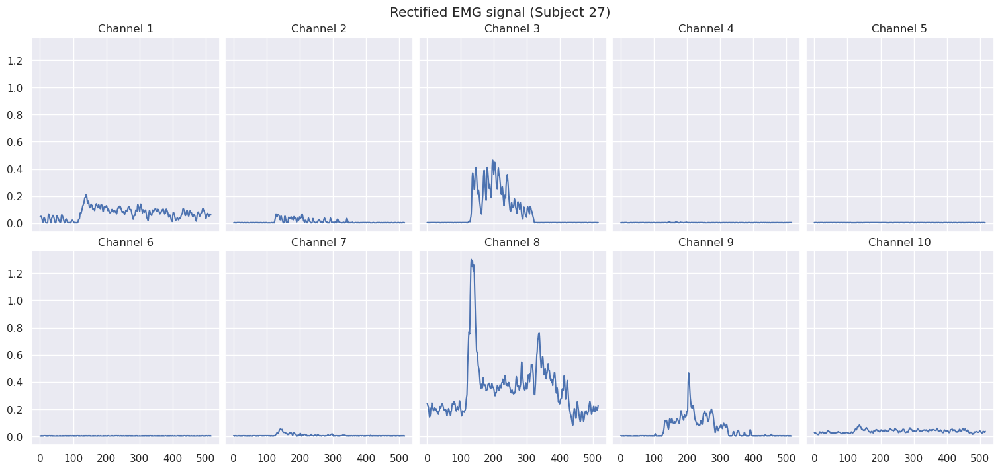

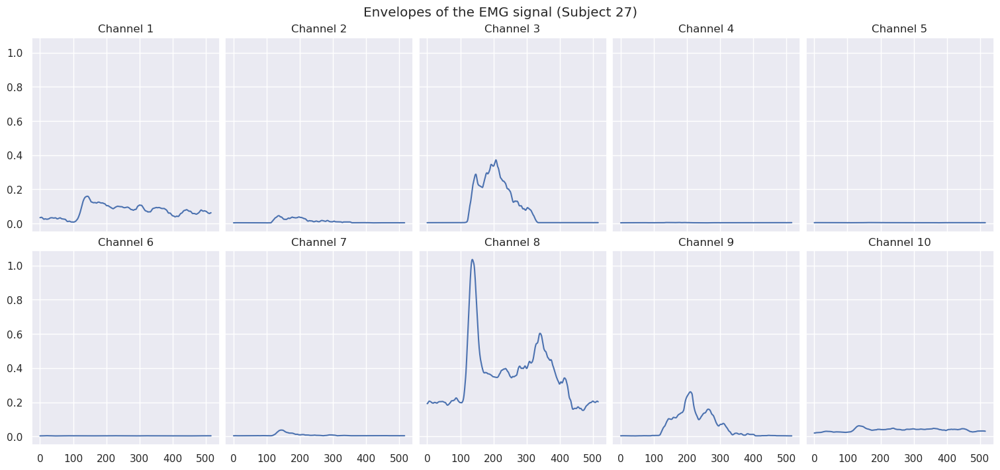

In [67]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from scipy.ndimage import convolve1d

# Number of subjects
n_subjects = 27

# Define moving average window size for envelope extraction
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        emg = data['emg']  # Assuming 'emg' is the name of the EMG data in the file

        # Calculate the number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)
        
        # Initialize arrays to store the EMG windows and envelopes
        emg_windows = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        emg_envelopes = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        
        # Calculate the number of samples per trial and preprocess the EMG signal
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the EMG data window for the current trial
                emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
                # Apply moving average to extract the envelope
                emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0)
        
        # Plot Rectified EMG signals for the subject
        trial = emg_windows[6][0]  # Example: Subject 6, first stimulus, first repetition
        
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True, sharex=True, sharey=True)
        ax = ax.ravel()

        number_of_emg_channels = emg.shape[-1]
        
        # Plot Rectified EMG signals (one for each channel)
        for channel_idx in range(number_of_emg_channels): 
            ax[channel_idx].plot(trial[:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Rectified EMG signal (Subject {subject})")

        # Plot Envelopes of the EMG signals for the subject
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True, sharex=True, sharey=True)
        ax = ax.ravel()

        # Plot Envelopes of the EMG signal (one for each channel)
        for channel_idx in range(number_of_emg_channels): 
            ax[channel_idx].plot(emg_envelopes[6][0][:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Envelopes of the EMG signal (Subject {subject})")

    else:
        print(f"Data file for Subject {subject} not found at {data_path}")


### Average EMG Activation Across Stimuli and Repetitions

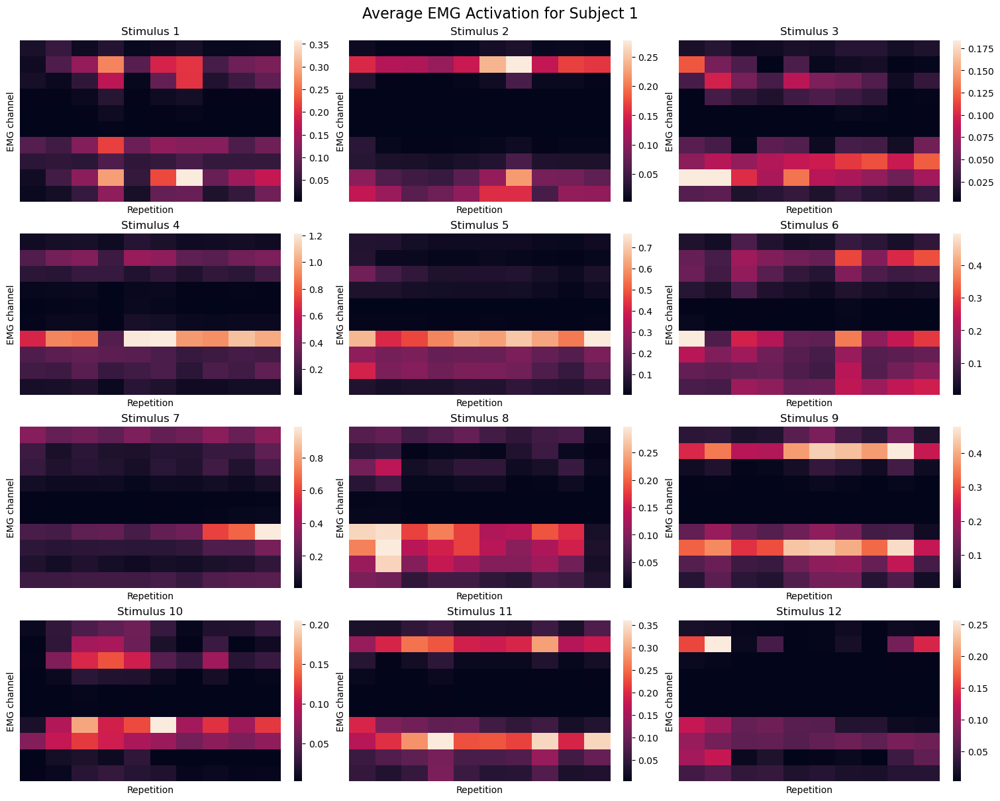

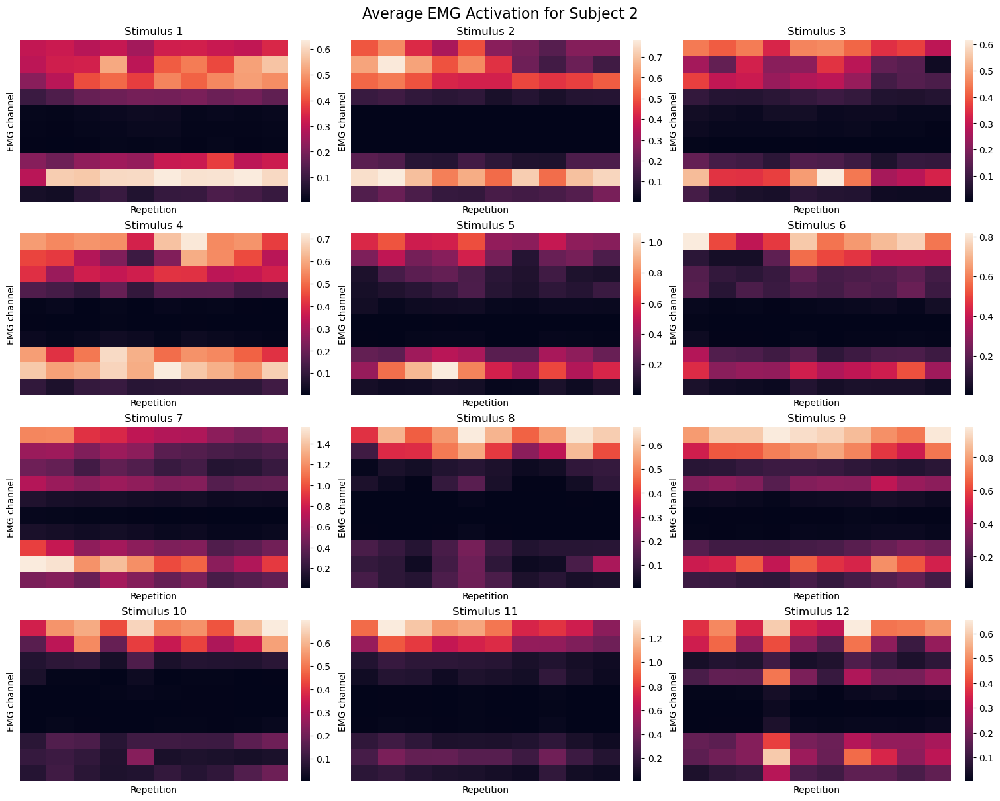

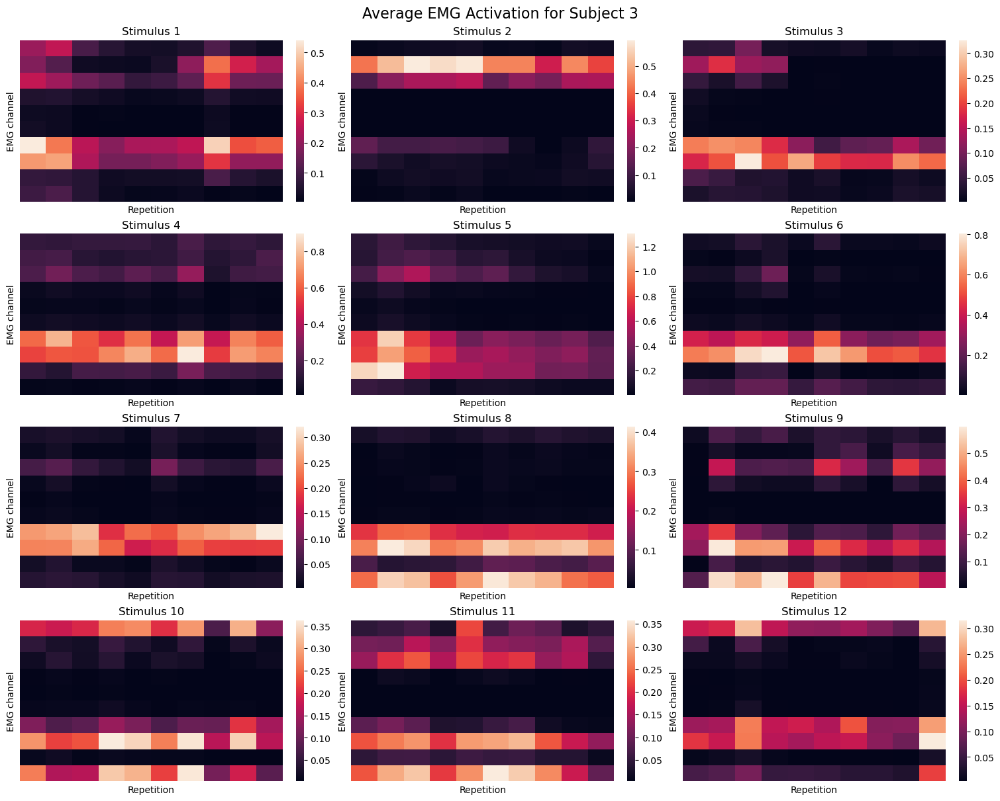

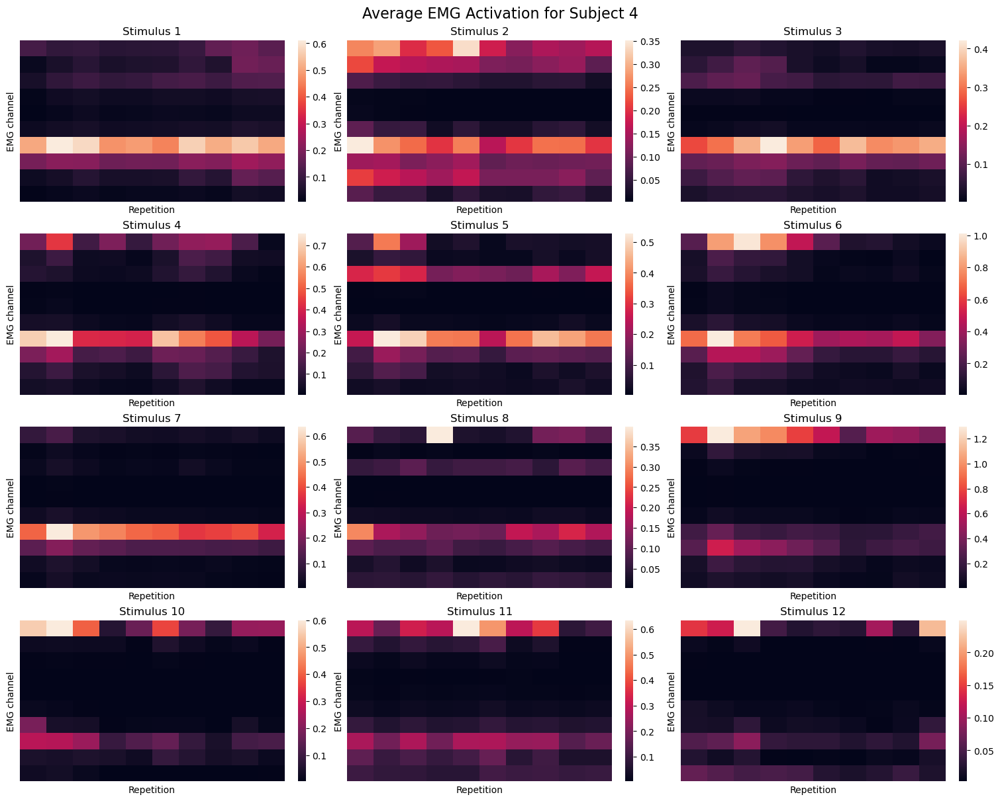

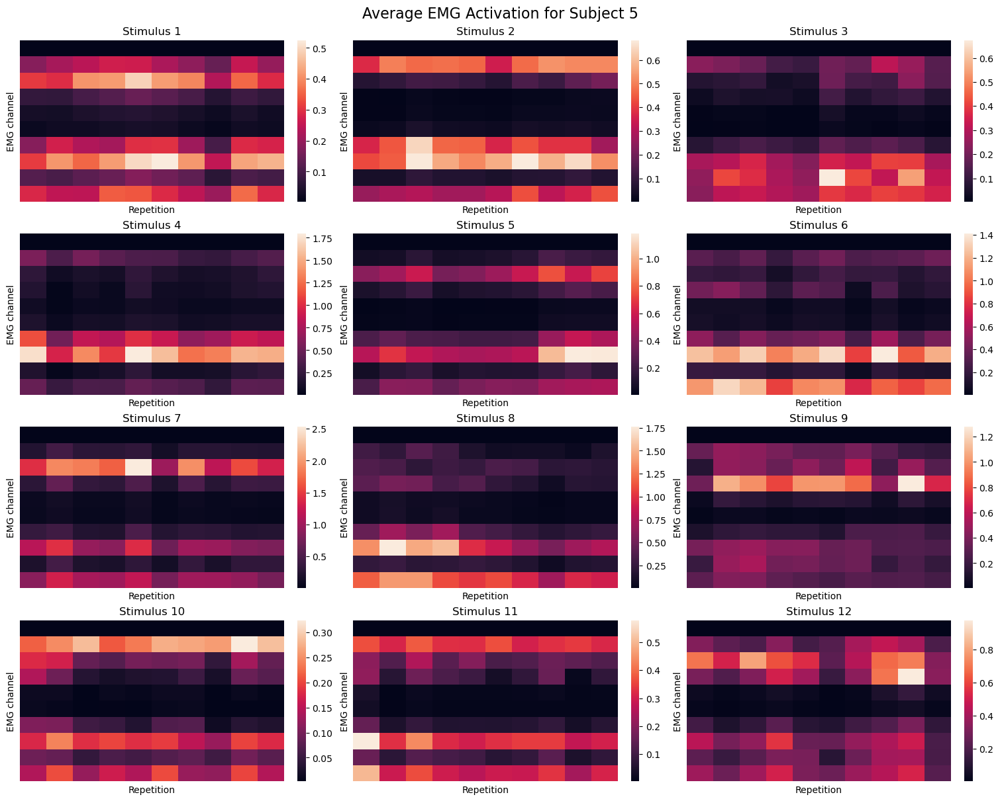

...

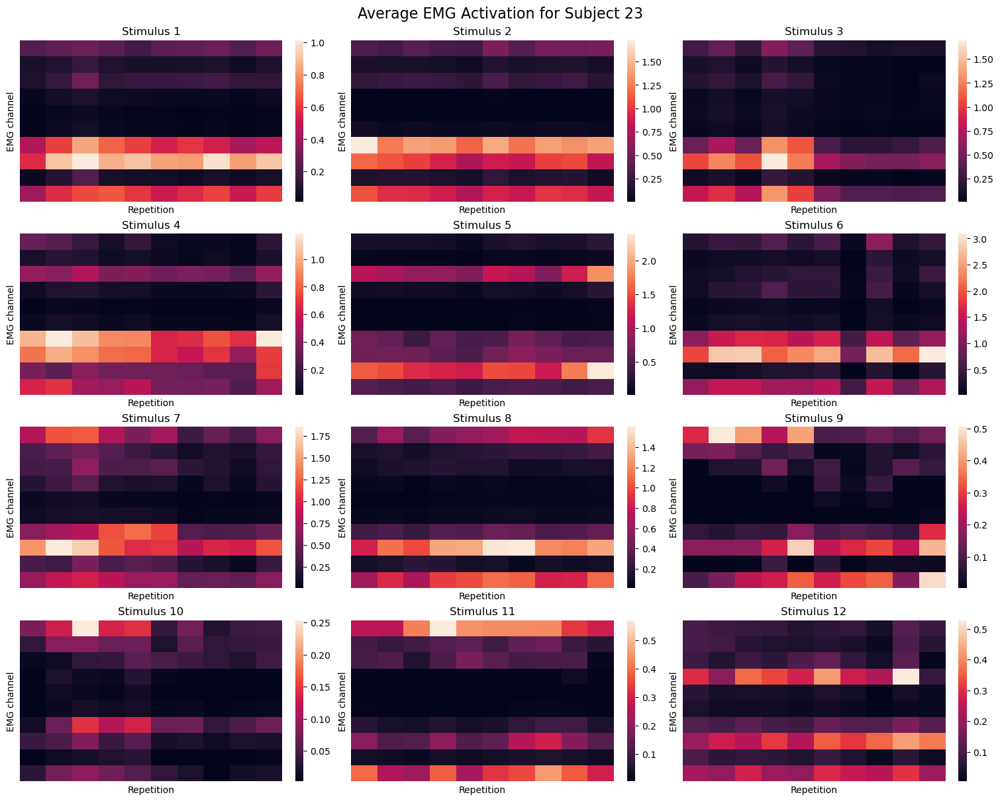

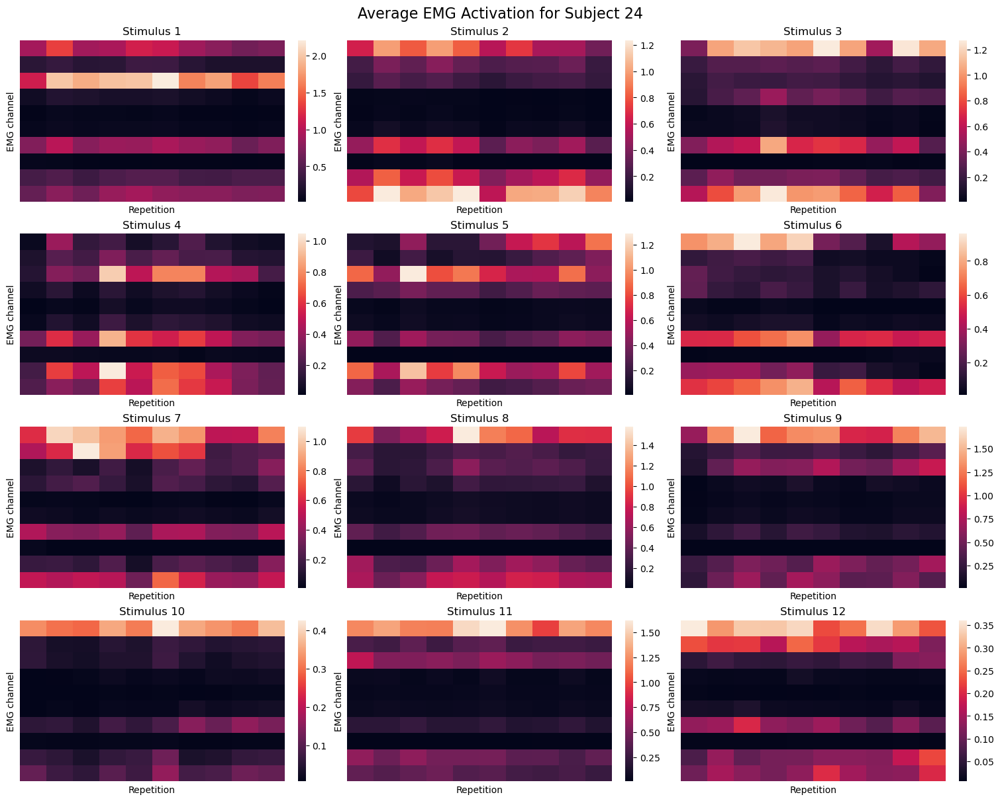

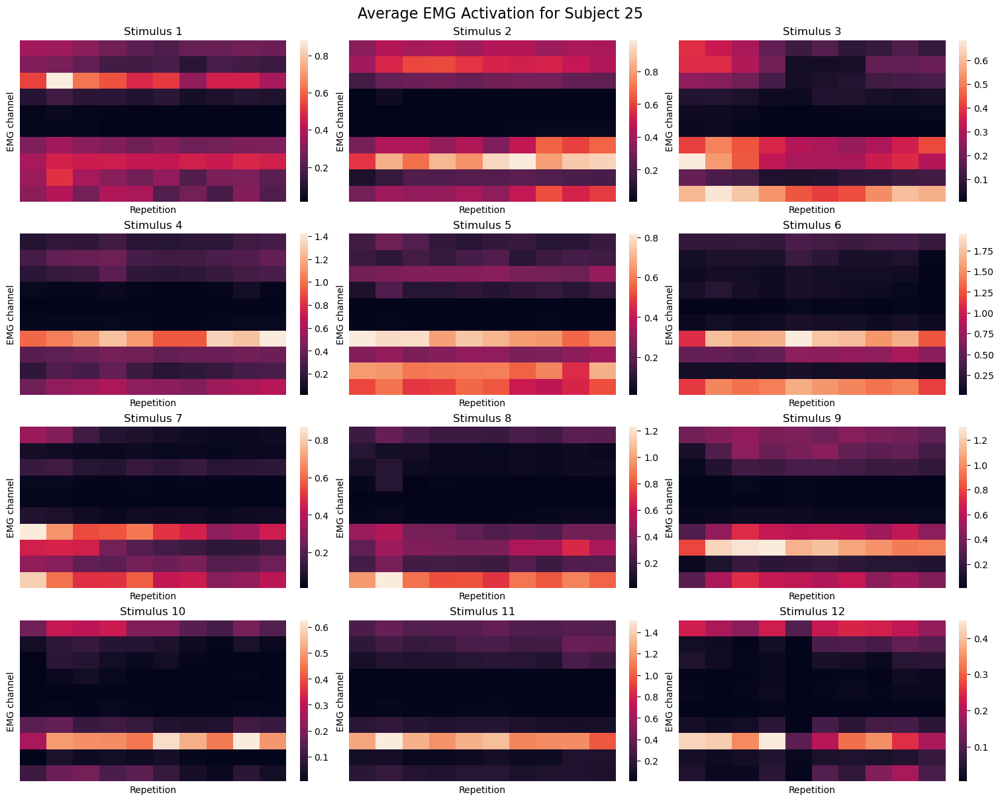

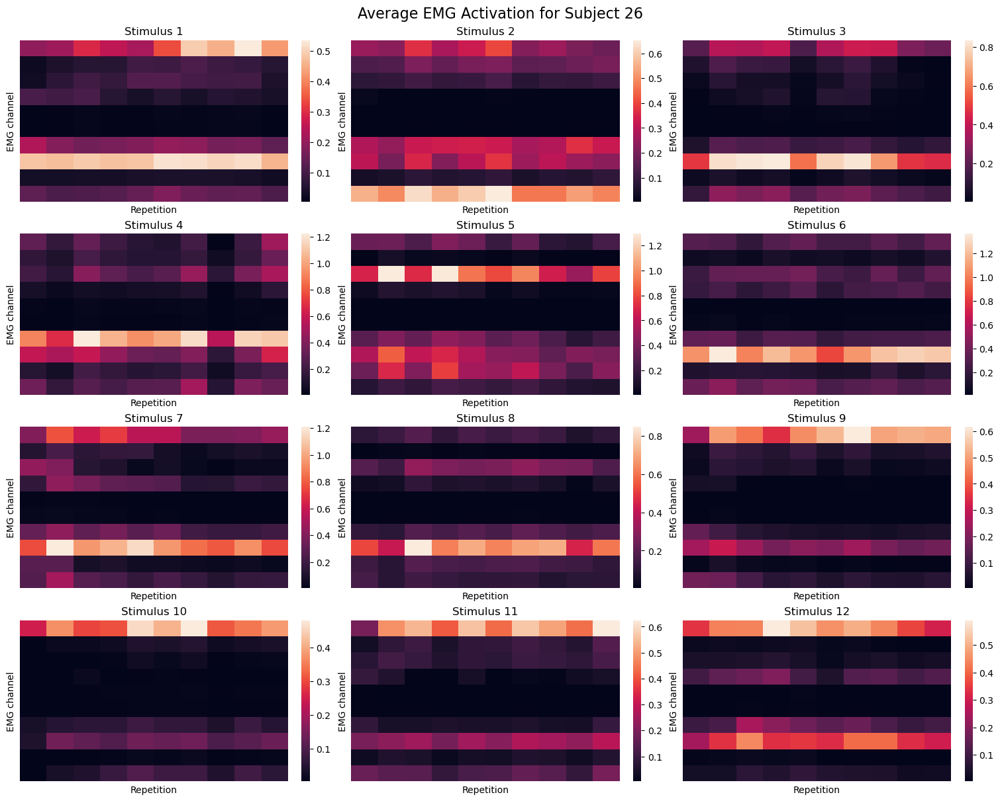

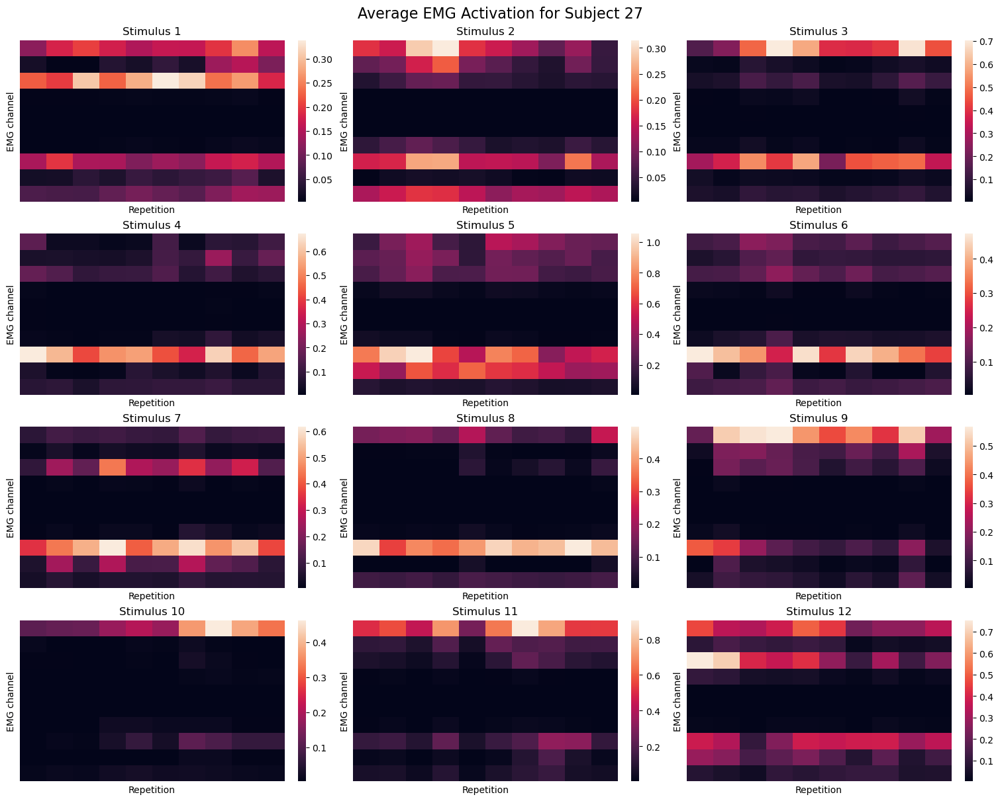

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from scipy.ndimage import convolve1d
import os

# Number of subjects
n_subjects = 27

# Define moving average window size for envelope extraction
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        emg = data['emg']  # Assuming 'emg' is the name of the EMG data in the file

        # Calculate the number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)
        
        # Initialize arrays to store the EMG windows and envelopes
        emg_windows = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        emg_envelopes = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        
        # Calculate the number of samples per trial and preprocess the EMG signal
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the EMG data window for the current trial
                emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
                # Apply moving average to extract the envelope
                emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0)
        
        # Now calculate the average activation across time for each channel, stimulus, and repetition
        n_channels = emg.shape[1]  # Number of EMG channels
        emg_average_activations = np.zeros((n_channels, n_stimuli, n_repetitions))

        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Mean across time for each channel
                emg_average_activations[:, stimuli_idx, repetition_idx] = np.mean(emg_envelopes[stimuli_idx][repetition_idx], axis=0)

        # Plot the heatmaps for each stimulus
        fig, ax = plt.subplots(4, 3, figsize=(15, 12), constrained_layout=True, sharex=True, sharey=True)
        ax = ax.ravel()

        for stimuli_idx in range(n_stimuli):
            sns.heatmap(np.squeeze(emg_average_activations[:, stimuli_idx, :]), ax=ax[stimuli_idx],
                        xticklabels=False, yticklabels=False, cbar=True)
            ax[stimuli_idx].title.set_text("Stimulus " + str(stimuli_idx + 1))
            ax[stimuli_idx].set_xlabel("Repetition")
            ax[stimuli_idx].set_ylabel("EMG channel")
        
        plt.suptitle(f"Average EMG Activation for Subject {subject}", fontsize=16)
        plt.show()  # Display the heatmaps for the current subject
    
    else:
        print(f"Data file for Subject {subject} not found at {data_path}")


### Extraction of Features

In [80]:
import os
import numpy as np
from scipy.io import loadmat

# Feature functions (same as before)
mav = lambda x: np.mean(np.abs(x), axis=0)
std = lambda x: np.std(x, axis=0)
maxav = lambda x: np.max(np.abs(x), axis=0)
rms = lambda x: np.sqrt(np.mean(x**2, axis=0))
wl = lambda x: np.sum(np.abs(np.diff(x, axis=0)), axis=0)
ssc = lambda x: np.sum((np.diff(x, axis=0)[:-1, :] * np.diff(x, axis=0)[1:, :]) < 0, axis=0)

# Define the feature extraction function for one subject
def build_dataset_from_ninapro(emg, stimulus, repetition, features=None):
    # Calculate the number of unique stimuli and repetitions, subtracting 1 to exclude the resting condition
    n_stimuli = np.unique(stimulus).size - 1  # excluding resting condition (0 or 1)
    n_repetitions = np.unique(repetition).size - 1
    # Total number of samples is the product of stimuli and repetitions
    n_samples = n_stimuli * n_repetitions
    
    # Number of channels in the EMG data
    n_channels = emg.shape[1]
    # Calculate the total number of features by summing the number of channels for each feature
    n_features = sum(n_channels for feature in features)
    
    # Initialize the dataset and labels arrays with zeros
    dataset = np.zeros((n_samples, n_features))
    labels = np.zeros(n_samples)
    current_sample_index = 0
    
    # Loop over each stimulus and repetition to extract features
    for i in range(n_stimuli):
        for j in range(n_repetitions):
            # Assign the label for the current sample (the stimulus label is i + 1)
            labels[current_sample_index] = i + 1  # Label should range from 1 to 12 (assuming 12 stimuli)
            current_sample_index += 1
            current_feature_index = 0
            # Select the time steps corresponding to the current stimulus and repetition
            selected_tsteps = np.logical_and(stimulus == i + 1, repetition == j + 1).squeeze()
            
            # Loop over each feature function provided
            for feature in features:
                # Determine the indices in the dataset where the current feature will be stored
                selected_features = np.arange(current_feature_index, current_feature_index + n_channels)
                # Apply the feature function to the selected EMG data and store the result
                dataset[current_sample_index-1, selected_features] = feature(emg[selected_tsteps, :])
                # Update the feature index for the next feature
                current_feature_index += n_channels

    return dataset, labels

# Function to extract features for all subjects
def build_dataset_from_ninapro_all_subjects(subject_data_list, features=None):
    all_datasets = []
    all_labels = []
    
    # Loop over all subjects' data
    for subject_index, (emg, stimulus, repetition) in enumerate(subject_data_list):
        # Extract features for the current subject using the provided feature functions
        dataset, labels = build_dataset_from_ninapro(
            emg=emg,
            stimulus=stimulus,
            repetition=repetition,
            features=features
        )
        
        # Append the dataset and labels for this subject to the overall lists
        all_datasets.append(dataset)
        all_labels.append(labels)
    
    # Concatenate all datasets and labels from all subjects
    final_dataset = np.vstack(all_datasets)
    final_labels = np.concatenate(all_labels)
    
    return final_dataset, final_labels


# Initialize a list to store data for all subjects
subject_data_list = []

# Loop over subjects 1 to 27 and load the data for each subject
for subject in range(1, 28):
    # Construct the path for each subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    # Check if the file exists before trying to load it
    if os.path.exists(data_path):
        data = loadmat(data_path)
        
        # Extract EMG data
        emg = data["emg"]
        stimulus = data["stimulus"].squeeze()  # Assuming stimulus is stored under the key 'stimulus'
        repetition = data["repetition"].squeeze()  # Assuming repetition is under the key 'repetition'
        
        # Add the subject data to the list
        subject_data_list.append((emg, stimulus, repetition))
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")

# After this loop, subject_data_list contains the (emg, stimulus, repetition) tuples for each subject

# Now we can call the function to extract features for all subjects
final_dataset, final_labels = build_dataset_from_ninapro_all_subjects(
    subject_data_list,
    features=[mav, std, maxav, rms, wl, ssc]  # List of features to extract
)

print(f"Final dataset shape: {final_dataset.shape}")
print(f"Final labels shape: {final_labels.shape}")
print(f"Unique labels: {np.unique(final_labels)}")


Final dataset shape: (3240, 60)
Final labels shape: (3240,)
Unique labels: [ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12.]


### Visualization of Features across the 27 Subjects

1) Visualize the Variance of Features Across Repetitions (Heatmap)

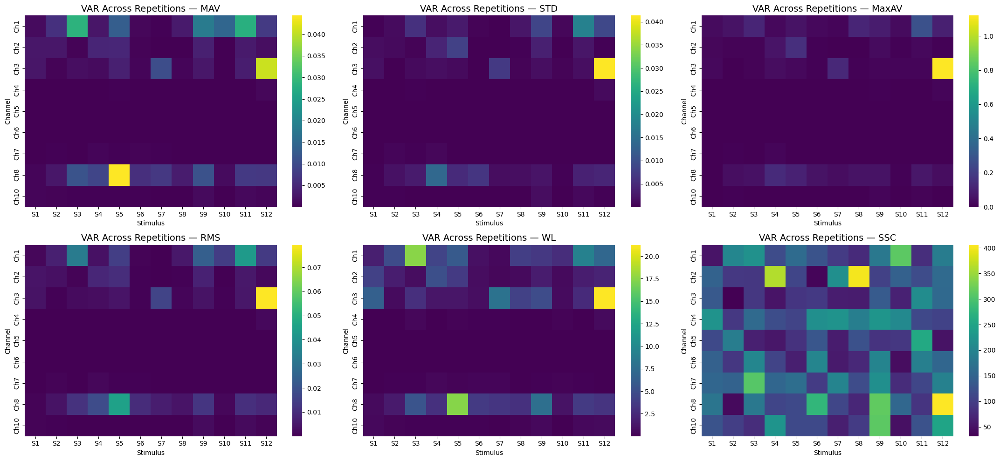

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt

# Extract unique stimuli and repetitions
stimuli = np.unique(stimulus)
stimuli = stimuli[stimuli != 0]
reps = np.unique(repetition)
reps = reps[reps != 0]

# Remove channel 9 (index=8)
channels_to_use = [i for i in range(emg.shape[1]) if i != 8]
n_channels = len(channels_to_use)

# Slice EMG to remove channel 9
emg_used = emg[:, channels_to_use]

# Feature names
features = {
    "MAV": mav,
    "STD": std,
    "MaxAV": maxav,
    "RMS": rms,
    "WL": wl,
    "SSC": ssc
}

# Compute variance of each feature across repetitions
variance_maps = {}

for fname, func in features.items():
    var_matrix = np.zeros((n_channels, len(stimuli)))

    for s_i, stim_val in enumerate(stimuli):
        feature_values_per_rep = np.zeros((len(reps), n_channels))

        for r_i, rep_val in enumerate(reps):
            mask = np.logical_and(stimulus == stim_val, repetition == rep_val).squeeze()
            segment = emg_used[mask, :]

            if segment.size > 0:
                feature_values_per_rep[r_i, :] = func(segment)
            else:
                feature_values_per_rep[r_i, :] = np.nan

        # variance across repetitions
        var_matrix[:, s_i] = np.nanvar(feature_values_per_rep, axis=0)

    variance_maps[fname] = var_matrix

# Plot 6 heatmaps (for each feature)
fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()

for ax, (fname, mat) in zip(axes, variance_maps.items()):
    sns.heatmap(
        mat,
        ax=ax,
        cmap="viridis",
        xticklabels=[f"S{int(s)}" for s in stimuli],
        yticklabels=[f"Ch{channels_to_use[c]+1}" for c in range(n_channels)],
        cbar=True
    )
    ax.set_title(f"VAR Across Repetitions — {fname}", fontsize=14)
    ax.set_xlabel("Stimulus")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()


2) Visualize Feature Values Across Repetitions (For One Stimulus)

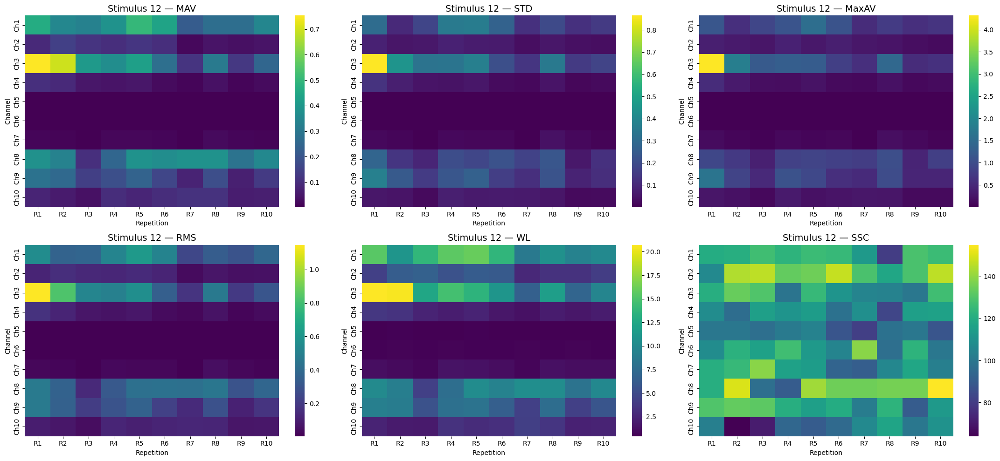

In [29]:
# Set a stimulus to plot
stim_to_plot = 12

# Extract repetitions
reps = np.unique(repetition)
reps = reps[reps != 0]
n_reps = len(reps)
n_channels = emg.shape[1]

# Plot feature values for the selected stimulus
fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()

for ax, (fname, func) in zip(axes, features.items()):
    heatmap_data = np.zeros((n_channels, n_reps))

    for r_i, rep in enumerate(reps):
        mask = np.logical_and(stimulus == stim_to_plot, repetition == rep).squeeze()
        segment = emg[mask, :]

        if segment.size > 0:
            heatmap_data[:, r_i] = func(segment)
        else:
            heatmap_data[:, r_i] = np.nan

    sns.heatmap(
        heatmap_data,
        ax=ax,
        cmap="viridis",
        cbar=True,
        xticklabels=[f"R{int(r)}" for r in reps],
        yticklabels=[f"Ch{c+1}" for c in range(n_channels)]
    )

    ax.set_title(f"Stimulus {stim_to_plot} — {fname}", fontsize=14)
    ax.set_xlabel("Repetition")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()


3) Plot Feature Means Across Gestures (Mean ± STD)

/tmp/ipykernel_394/1292087344.py:36: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


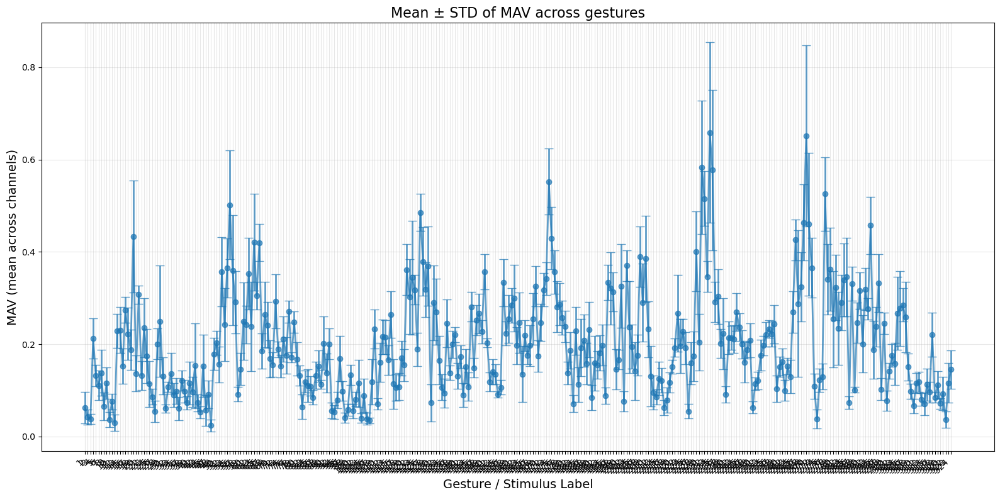

/tmp/ipykernel_394/1292087344.py:36: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


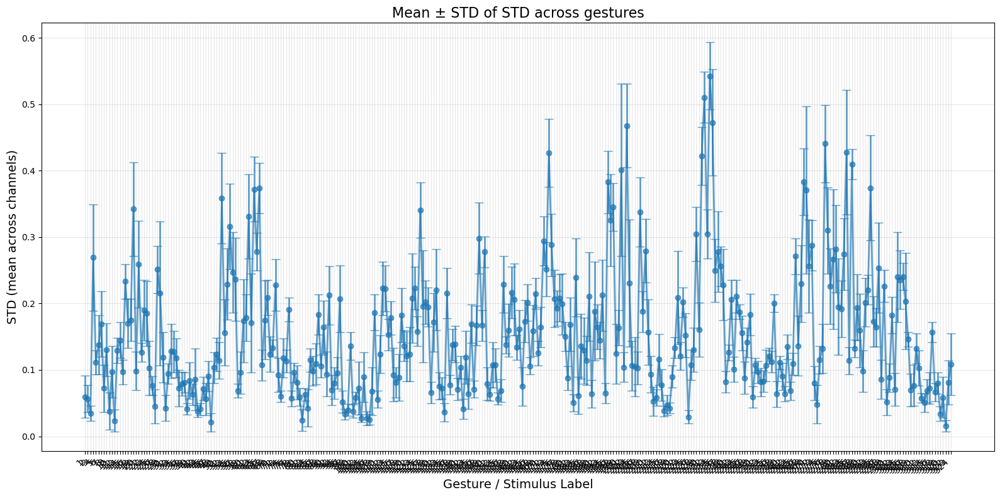

/tmp/ipykernel_394/1292087344.py:36: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


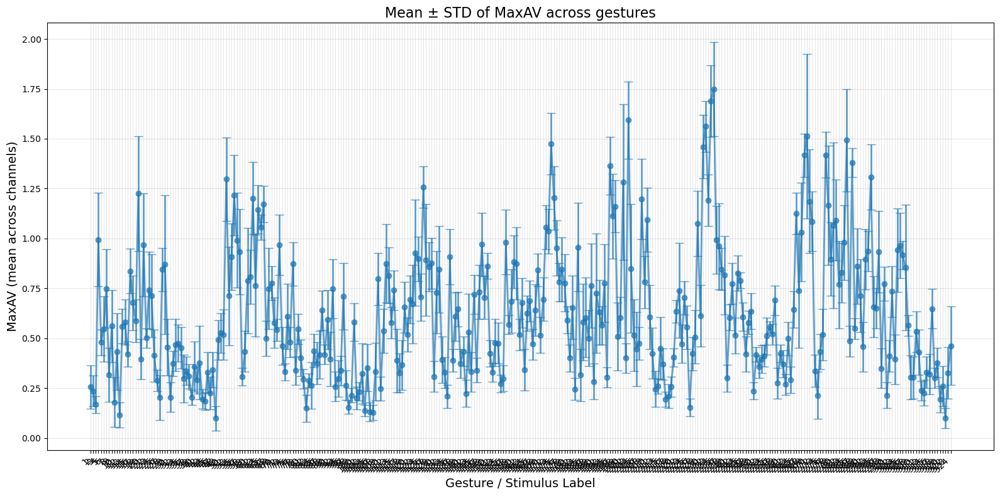

/tmp/ipykernel_394/1292087344.py:36: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


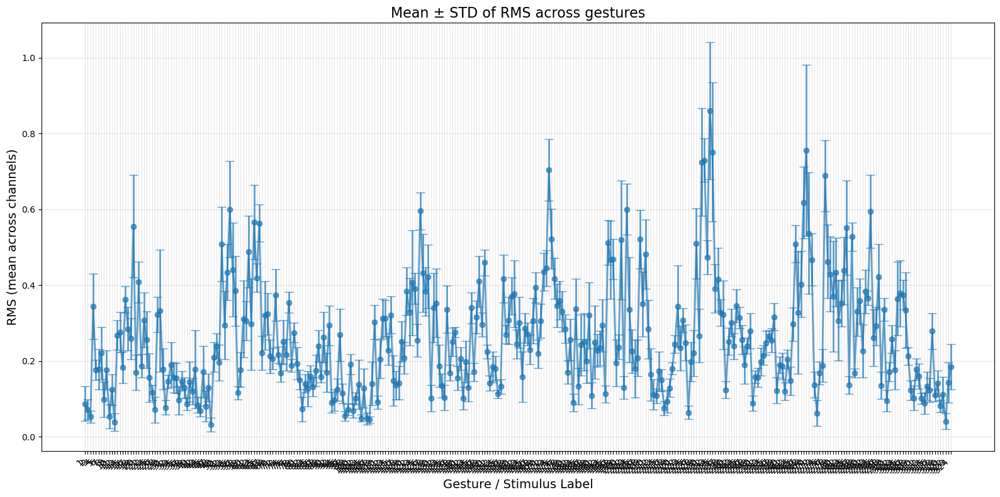

/tmp/ipykernel_394/1292087344.py:36: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


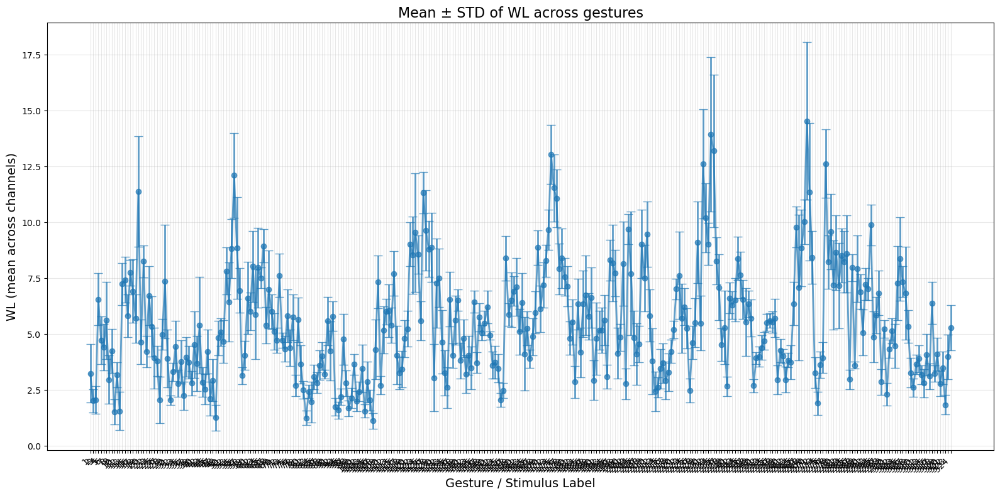

/tmp/ipykernel_394/1292087344.py:36: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


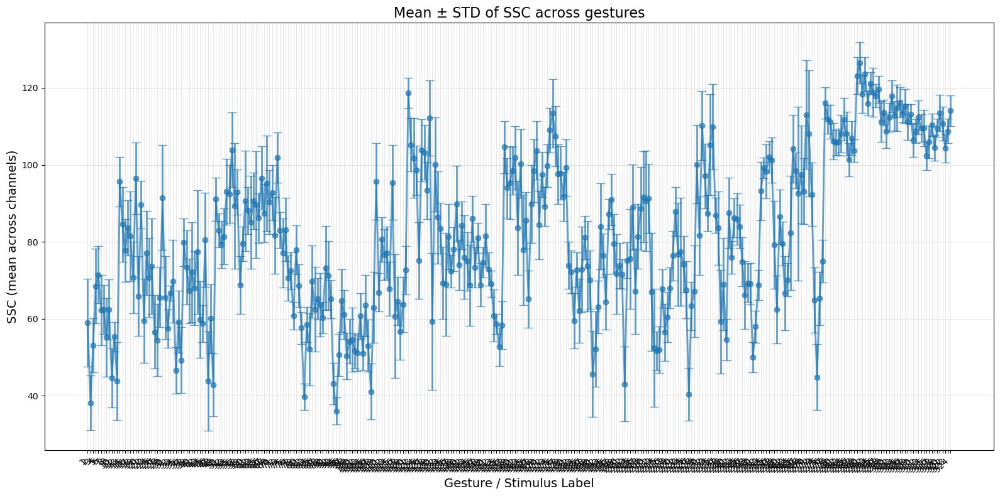

In [30]:
import pandas as pd
import numpy as np

# Number of EMG channels
n_channels = emg.shape[1]

# Feature names (must match the order used in your dataset builder)
feature_names = ["MAV", "STD", "MaxAV", "RMS", "WL", "SSC"]

# Expand feature names to channel-level: e.g. MAV_ch1, MAV_ch2, ...
all_feature_labels = []
for fname in feature_names:
    all_feature_labels.extend([f"{fname}_ch{ch+1}" for ch in range(n_channels)])

# Convert dataset to a DataFrame for easy plotting
df = pd.DataFrame(final_dataset, columns=all_feature_labels)
df["label"] = final_labels.astype(int)

import matplotlib.pyplot as plt
import numpy as np

# Create custom x-axis positions
x_positions = np.arange(len(means)) * 2  # Multiply by 2 to increase spacing

# Plot Mean ± STD with increased spacing
for fname in feature_names:
    feature_cols = [col for col in df.columns if col.startswith(fname)]
    df[f"{fname}_mean"] = df[feature_cols].mean(axis=1)

    means = df.groupby("label")[f"{fname}_mean"].mean()
    stds = df.groupby("label")[f"{fname}_mean"].std()

    plt.figure(figsize=(16, 8))

    # Use error bars and custom x-axis positions
    plt.errorbar(
        x_positions, means.values, yerr=stds.values, fmt='-o', capsize=5,
        alpha=0.7, linestyle='-', linewidth=2, markersize=6, label=fname
    )

    # Title and labels
    plt.title(f"Mean ± STD of {fname} across gestures", fontsize=16)
    plt.xlabel("Gesture / Stimulus Label", fontsize=14)
    plt.ylabel(f"{fname} (mean across channels)", fontsize=14)

    # Customize x-axis ticks to correspond to labels
    plt.xticks(x_positions, means.index, rotation=45, ha='right')

    # Add grid
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()



### Classification : Trained on 26 Subjects, Tested on 1 Subject

In [81]:
#DEBU
import numpy as np

# Checking the shape of the final dataset
print(f"Shape of final dataset: {final_dataset.shape}")
print(f"Shape of final labels: {final_labels.shape}")

# Ensure there are no empty subjects
for subject in range(1, 13):  # 1 to 12 for subjects
    # Find the indices corresponding to the current subject
    subject_indices = np.where(final_labels == subject)[0]
    
    # Extract data for this subject
    subject_data = final_dataset[subject_indices]
    
    # Extract labels for this subject
    subject_labels = final_labels[subject_indices]
    
    # Print the shapes of the data and labels for each subject
    print(f"Subject {subject} data shape: {subject_data.shape}")
    print(f"Subject {subject} labels shape: {subject_labels.shape}")


Shape of final dataset: (3240, 60)
Shape of final labels: (3240,)
Subject 1 data shape: (270, 60)
Subject 1 labels shape: (270,)
Subject 2 data shape: (270, 60)
Subject 2 labels shape: (270,)
Subject 3 data shape: (270, 60)
Subject 3 labels shape: (270,)
Subject 4 data shape: (270, 60)
Subject 4 labels shape: (270,)
Subject 5 data shape: (270, 60)
Subject 5 labels shape: (270,)
Subject 6 data shape: (270, 60)
Subject 6 labels shape: (270,)
Subject 7 data shape: (270, 60)
Subject 7 labels shape: (270,)
Subject 8 data shape: (270, 60)
Subject 8 labels shape: (270,)
Subject 9 data shape: (270, 60)
Subject 9 labels shape: (270,)
Subject 10 data shape: (270, 60)
Subject 10 labels shape: (270,)
Subject 11 data shape: (270, 60)
Subject 11 labels shape: (270,)
Subject 12 data shape: (270, 60)
Subject 12 labels shape: (270,)


In [82]:
#DEBUG
# Remove the samples with label 0 from the dataset and labels
mask = final_labels_int != 0  # Create a mask for non-zero labels
final_labels_no_zero = final_labels_int[mask]
final_dataset_no_zero = final_dataset[mask]

# Re-assign the labels to start from 1 (to make sure there are no label 0s)
# This will ensure the labels go from 1 to 12 as expected.
unique_labels = np.unique(final_labels_no_zero)
label_map = {label: i+1 for i, label in enumerate(unique_labels)}

# Apply the label map to the dataset to ensure labels are reassigned correctly
final_labels_corrected = np.array([label_map[label] for label in final_labels_no_zero])

# Check the class counts again after reassigning labels
class_counts_corrected = np.bincount(final_labels_corrected)
print("Class counts (after removing label 0 and reassigning labels):", class_counts_corrected)

# Check some random samples to make sure the labels are assigned correctly
import random

random_indices = random.sample(range(len(final_labels_corrected)), 10)

for idx in random_indices:
    print(f"Sample {idx}: Label = {final_labels_corrected[idx]}, Data = {final_dataset_no_zero[idx]}")


Class counts (after removing label 0 and reassigning labels): [  0 270 270 270 270 270 270 270 270 270 270 270 270]
Sample 3006: Label = 1, Data = [4.91639729e-01 1.10668023e-01 1.00139535e-01 3.81589147e-02
 9.76375969e-03 9.42790698e-03 1.94742054e-01 5.18356008e-01
 4.35023256e-02 1.48448062e-01 2.60661837e-01 1.22531761e-01
 1.18916798e-01 3.84301377e-02 1.40565919e-02 1.36650645e-02
 1.26720279e-01 2.12424678e-01 5.73472352e-02 7.23591833e-02
 1.14260000e+00 8.61800000e-01 5.07800000e-01 1.48900000e-01
 7.57000000e-02 6.59000000e-02 5.73700000e-01 9.93700000e-01
 3.17400000e-01 4.12600000e-01 5.56465827e-01 1.65110399e-01
 1.55464245e-01 5.41569779e-02 1.71148701e-02 1.66017896e-02
 2.32341337e-01 5.60193890e-01 7.19802592e-02 1.65144417e-01
 1.30019000e+01 5.91700000e+00 5.53260000e+00 2.43870000e+00
 8.15200000e-01 7.15800000e-01 5.41190000e+00 1.06640000e+01
 2.23100000e+00 4.07180000e+00 1.62000000e+02 1.10000000e+02
 1.12000000e+02 9.80000000e+01 9.40000000e+01 9.60000000e+01

In [83]:
#DEBUG
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(final_dataset, final_labels_corrected, test_size=0.2, random_state=42)
print(f"Train set labels: {np.unique(y_train)}")
print(f"Test set labels: {np.unique(y_test)}")


Train set labels: [ 1  2  3  4  5  6  7  8  9 10 11 12]
Test set labels: [ 1  2  3  4  5  6  7  8  9 10 11 12]


In [86]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Perform train-test split (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(final_dataset, final_labels_corrected, test_size=0.2, random_state=42)

# Train a Random Forest classifier
clf = RandomForestClassifier(random_state=42)

# Fit the model on the training data
clf.fit(X_train, y_train)

# Predict on the test data
y_pred = clf.predict(X_test)

# Confusion Matrix to evaluate performance
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# Classification Report to show precision, recall, and F1-score for each class
print("\nClassification Report:")
print(classification_report(y_test, y_pred))


Confusion Matrix:
[[46  0  1  1  1  0  1  0  0  1  0  1]
 [ 2 45  0  0  0  2  0  0  1  0  0  0]
 [ 2  1 33  3  1  0  1  2  0  1  0  1]
 [ 0  0  0 49  0  2  0  0  0  0  2  0]
 [ 0  0  0  0 50  0  4  0  0  0  0  1]
 [ 0  0  2  6  1 46  2  1  0  0  3  3]
 [ 4  0  0  2  0  1 55  0  0  0  0  0]
 [ 0  1  2  1  1  1  2 48  0  1  0  2]
 [ 0  0  1  2  0  1  0  4 38  1  3  2]
 [ 2  0  0  0  0  0  0  0  1 43  3  2]
 [ 0  0  0  0  0  0  0  1  7  2 41  0]
 [ 2  3  0  1  0  0  0  0  2  7  1 38]]

Classification Report:
              precision    recall  f1-score   support

           1       0.79      0.88      0.84        52
           2       0.90      0.90      0.90        50
           3       0.85      0.73      0.79        45
           4       0.75      0.92      0.83        53
           5       0.93      0.91      0.92        55
           6       0.87      0.72      0.79        64
           7       0.85      0.89      0.87        62
           8       0.86      0.81      0.83        59
  

### Leave-One-Subject-Out (LOSO) Cross-Validation : Rotating Test Subject for Model Evaluation 

In [68]:
import numpy as np
import pandas as pd
from sklearn.model_selection import GroupKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler

# Assuming final_dataset is a numpy array, let's convert it into a pandas DataFrame
# Create a 'subject_id' column for each subject
subject_ids = np.tile(np.arange(1, 28), len(final_labels_corrected) // 27)  # Create subject_id array

# Convert final_dataset to DataFrame (assuming final_dataset is a numpy array)
final_dataset_df = pd.DataFrame(final_dataset)

# Add 'subject_id' to the dataframe
final_dataset_df['subject_id'] = subject_ids

# Checking the shape of the final dataset
print(f"Shape of final dataset (with subject_id): {final_dataset_df.shape}")

# Separate features (X) and labels (y)
X = final_dataset_df.drop(columns=['subject_id'])  # Drop subject_id to get features
y = final_labels_corrected  # Your corrected labels

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)  # Standardize the feature matrix

# Random Forest Classifier
clf = RandomForestClassifier(n_estimators=100, random_state=42)

# GroupKFold for Leave-One-Subject-Out Cross-Validation (LOSO-CV)
groups = final_dataset_df['subject_id']  # Subject IDs to ensure data from the same subject stays together
loso = GroupKFold(n_splits=27)  # One fold per subject

# Lists to store the results across all folds
accuracies = []
conf_matrices = []
class_reports = []

# Perform LOSO-CV
for train_index, test_index in loso.split(X_scaled, y, groups=groups):
    X_train, X_test = X_scaled[train_index], X_scaled[test_index]
    y_train, y_test = y[train_index], y[test_index]

    # Train the model
    clf.fit(X_train, y_train)
    
    # Make predictions
    y_pred = clf.predict(X_test)

    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    accuracies.append(accuracy)

    # Confusion Matrix
    conf_matrix = confusion_matrix(y_test, y_pred)
    conf_matrices.append(conf_matrix)

    # Classification Report
    class_report = classification_report(y_test, y_pred, output_dict=True)  # Use output_dict for further processing
    class_reports.append(class_report)

# Calculate average accuracy across all folds
average_accuracy = np.mean(accuracies)
print(f"Average Accuracy (LOSO-CV): {average_accuracy:.4f}")

# Optionally, print the confusion matrix and classification report for the last fold
print("\nConfusion Matrix for the last fold:")
print(conf_matrices[-1])

print("\nClassification Report for the last fold:")
from pprint import pprint
pprint(class_reports[-1])

# If you want to inspect accuracy per subject, you can print out the accuracies for each fold
print("\nAccuracy per fold:")
for fold, accuracy in enumerate(accuracies, 1):
    print(f"Fold {fold}: Accuracy = {accuracy:.4f}")


Shape of final dataset (with subject_id): (3240, 61)
Average Accuracy (LOSO-CV): 0.8765

Confusion Matrix for the last fold:
[[ 9  0  2  0  0  0  0  0  0  1  0  0]
 [ 0  9  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  8  1  0  0  0  0  0  0  0  0]
 [ 0  1  0 10  0  0  1  0  0  0  0  0]
 [ 0  0  0  0  9  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  9  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 11  1  0  0  0  0]
 [ 0  0  0  0  0  0  0  9  0  0  0  0]
 [ 0  0  1  0  0  0  0  2  5  0  1  0]
 [ 0  0  0  0  0  0  0  0  1 11  0  0]
 [ 0  0  0  0  0  0  0  0  1  0  8  0]
 [ 0  0  0  0  0  0  0  0  0  1  0  8]]

Classification Report for the last fold:
{'1': {'f1-score': 0.8571428571428571,
       'precision': 1.0,
       'recall': 0.75,
       'support': 12.0},
 '10': {'f1-score': 0.88,
        'precision': 0.8461538461538461,
        'recall': 0.9166666666666666,
        'support': 12.0},
 '11': {'f1-score': 0.8888888888888888,
        'precision': 0.8888888888888888,
        'recall': 0.8888888888888888,
  

Training on subjects: [1]
X_train shape: (270, 60) (Should not be empty for any iteration)
X_test shape: (0, 60) (Should contain samples from subject 27)
Training on subjects: [1, 2]
X_train shape: (540, 60) (Should not be empty for any iteration)
X_test shape: (0, 60) (Should contain samples from subject 27)
Training on subjects: [1, 2, 3]
X_train shape: (810, 60) (Should not be empty for any iteration)
X_test shape: (0, 60) (Should contain samples from subject 27)
Training on subjects: [1, 2, 3, 4]
X_train shape: (1080, 60) (Should not be empty for any iteration)
X_test shape: (0, 60) (Should contain samples from subject 27)
Training on subjects: [1, 2, 3, 4, 5]
X_train shape: (1350, 60) (Should not be empty for any iteration)
X_test shape: (0, 60) (Should contain samples from subject 27)
Training on subjects: [1, 2, 3, 4, 5, 6]
X_train shape: (1620, 60) (Should not be empty for any iteration)
X_test shape: (0, 60) (Should contain samples from subject 27)
Training on subjects: [1, 2,

ValueError: x and y must have same first dimension, but have shapes (26,) and (0,)

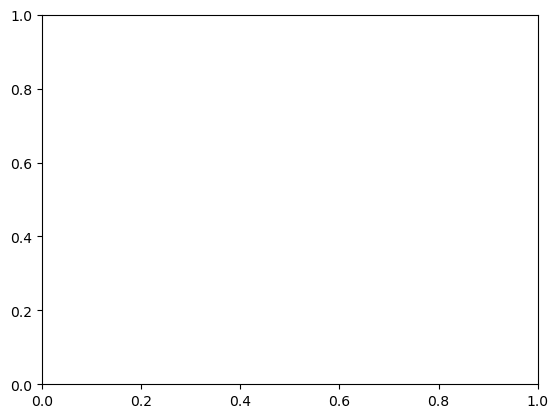

In [91]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt

# Initialize an empty list to store accuracy and other metrics
accuracies = []

# For this task, subject 27 is kept as the test subject
test_subject = 27

# Loop over the number of subjects to include in the training set
for n_train_subjects in range(1, 27):  # We train on 1 to 26 subjects
    # Collect the training data for the first n_train_subjects subjects excluding subject 27
    train_subjects = list(range(1, n_train_subjects + 1))
    
    # Ensure subject 27 is excluded from training subjects
    if test_subject in train_subjects:
        train_subjects.remove(test_subject)

    # Debugging: Check if subject 27 is excluded
    print(f"Training on subjects: {train_subjects}")

    # Create a mask for selecting the training data from the selected subjects (excluding subject 27)
    train_mask = np.isin(final_labels_corrected, train_subjects)
    X_train = final_dataset[train_mask]
    y_train = final_labels_corrected[train_mask]

    # Debugging: Check if X_train has the correct shape
    print(f"X_train shape: {X_train.shape} (Should not be empty for any iteration)")

    # Create the test mask to select subject 27 only for the test data
    test_mask = final_labels_corrected == test_subject
    X_test = final_dataset[test_mask]
    y_test = final_labels_corrected[test_mask]

    # Debugging: Check if X_test has the correct shape
    print(f"X_test shape: {X_test.shape} (Should contain samples from subject 27)")

    # Check if the test set is empty (it shouldn't be)
    if X_test.shape[0] == 0:
        print(f"Warning: No test samples for subject {test_subject} when training on subjects {train_subjects}")
        continue  # Skip this iteration if there's no test data for subject 27
    
    # Train the classifier
    clf = RandomForestClassifier(random_state=42)
    clf.fit(X_train, y_train)

    # Predict on the test set
    y_pred = clf.predict(X_test)

    # Calculate accuracy
    accuracy = np.mean(y_pred == y_test)
    accuracies.append(accuracy)

    # Get confusion matrix and classification report
    cm = confusion_matrix(y_test, y_pred)
    cr = classification_report(y_test, y_pred, output_dict=True)
    
    # Print results for the current fold
    print(f"Training on subjects {train_subjects} - Testing on subject {test_subject}")
    print(f"Accuracy: {accuracy:.4f}")
    print("Confusion Matrix:")
    print(cm)
    print("Classification Report:")
    print(cr)

# After looping through all subjects, you can analyze the trends
print("\nAccuracy across different training set sizes:")
for n_train_subjects, accuracy in enumerate(accuracies, 1):
    print(f"Training on {n_train_subjects} subjects: Accuracy = {accuracy:.4f}")

# You can now visualize the performance trends (e.g., using matplotlib for plotting)
plt.plot(range(1, 27), accuracies, marker='o')
plt.xlabel("Number of Subjects in Training Set")
plt.ylabel("Accuracy on Subject 27")
plt.title("Impact of Training Set Size on Model Accuracy")
plt.show()


In [74]:
# Ensure subject 27 is always in the test set during cross-validation
test_subjects = [27]  # For the test set, only include subject 27
train_subjects = [i for i in range(1, 28) if i not in test_subjects]  # Training on other subjects

print(f"Subjects in training: {train_subjects}")
print(f"Subjects in testing: {test_subjects}")

Subjects in training: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26]
Subjects in testing: [27]


-------------------------- TESTs POUR VERIFIER QUE TOUS LES TRIALS SONT OK ---------------------------------- PAS SURE QU'IL FAUT GARDER CA 
!

In [44]:
def check_trial_quality(signal):
    # signal shape = (time, channels)
    
    problems = []
    
    # Canal constant (toujours 0 ou quasi 0)
    if np.any(np.std(signal, axis=0) < 1e-4):
        problems.append("Canal constant (possiblement débranché)")
    
    # Saturation (valeurs proches du max)
    if np.any(np.max(signal, axis=0) > 5):
        problems.append("Saturation (clipping)")
    
    # Très faible variance → bruit faible, problème possible
    if np.mean(np.std(signal, axis=0)) < 0.01:
        problems.append("Faible variance globale")
        
    return problems


bad_trials = []

for s in range(n_stimuli):
    for r in range(n_repetitions):
        sig = emg_windows[s][r]
        issues = check_trial_quality(trial)
        if len(issues) > 0:
            bad_trials.append((s+1, r+1, issues))

bad_trials


[]

In [45]:
bad_trials = []  # liste des trials problématiques

for s in range(n_stimuli):
    for r in range(n_repetitions):

        signal = emg_windows[s][r]    # trial (temps × channels)

        issues = check_trial_quality(signal)

        if len(issues) > 0:
            bad_trials.append({
                "stimulus": s+1,
                "repetition": r+1,
                "problems": issues
            })


In [46]:
for entry in bad_trials:
    print(f"Stimulus {entry['stimulus']:2d}, "
          f"Répétition {entry['repetition']:2d}  →  {entry['problems']}")


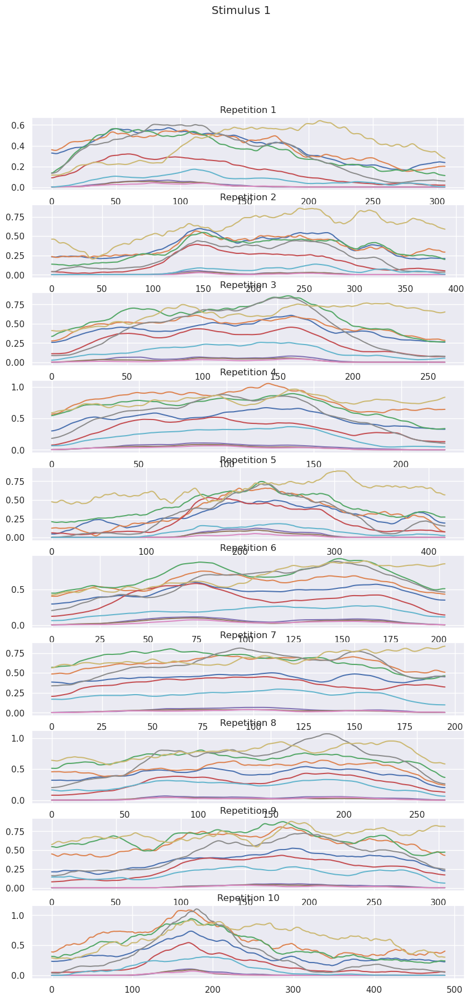

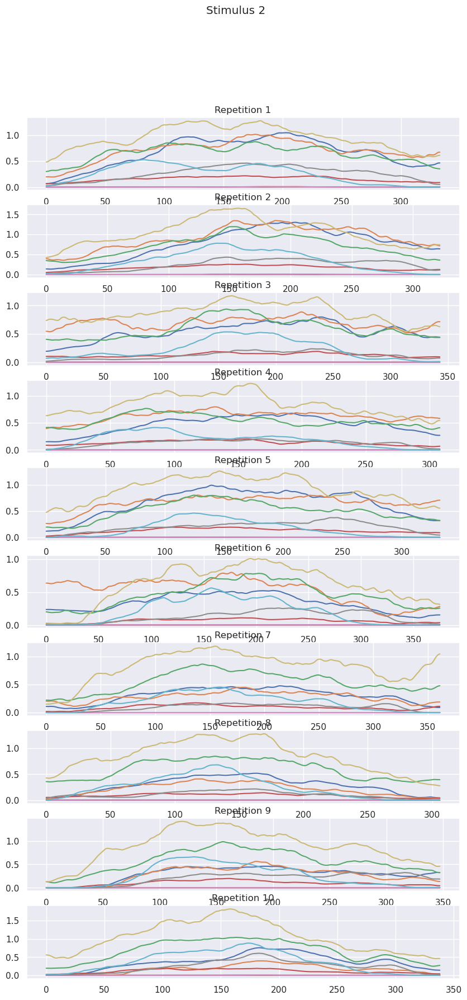

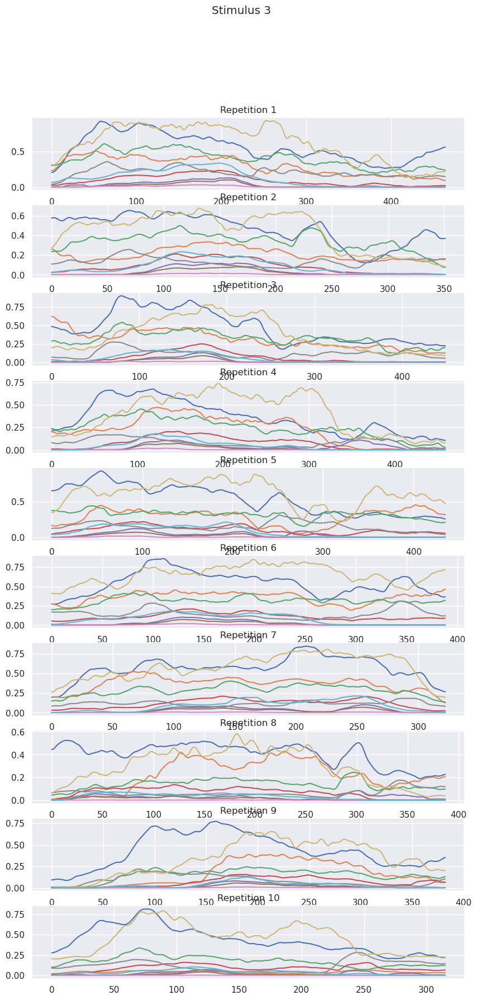

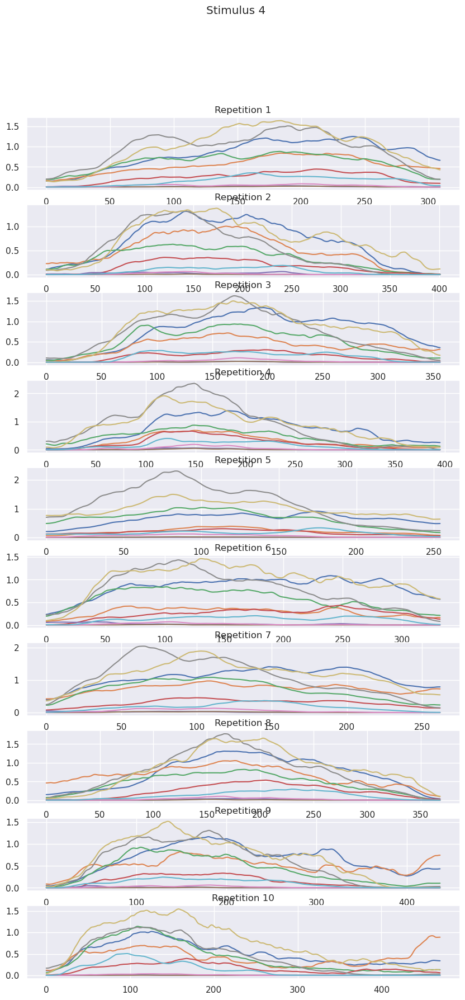

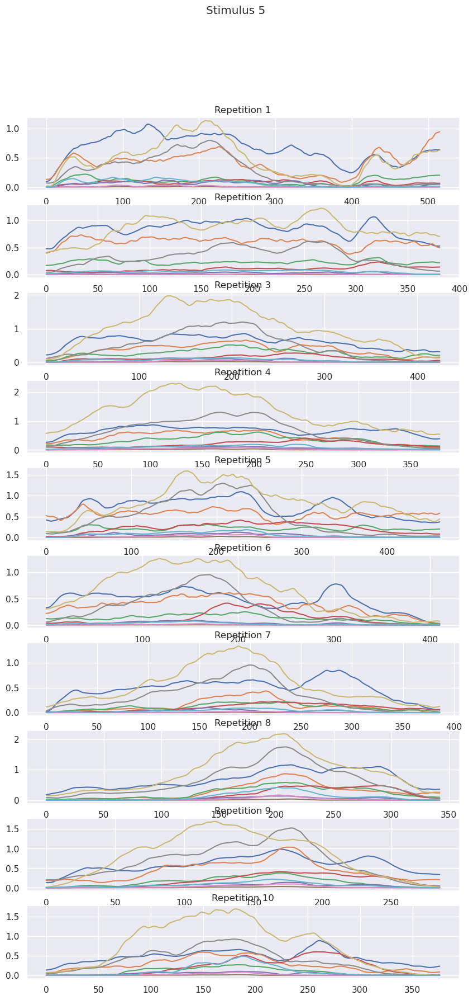

...

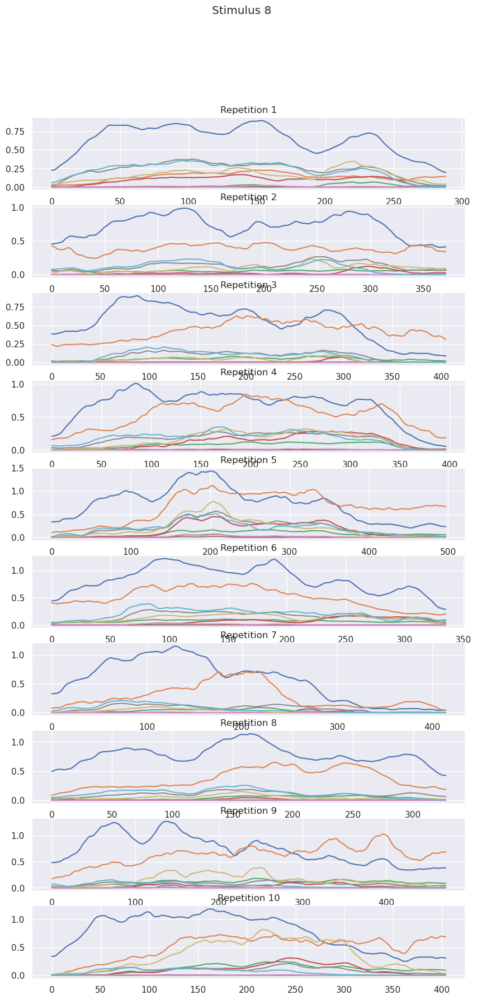

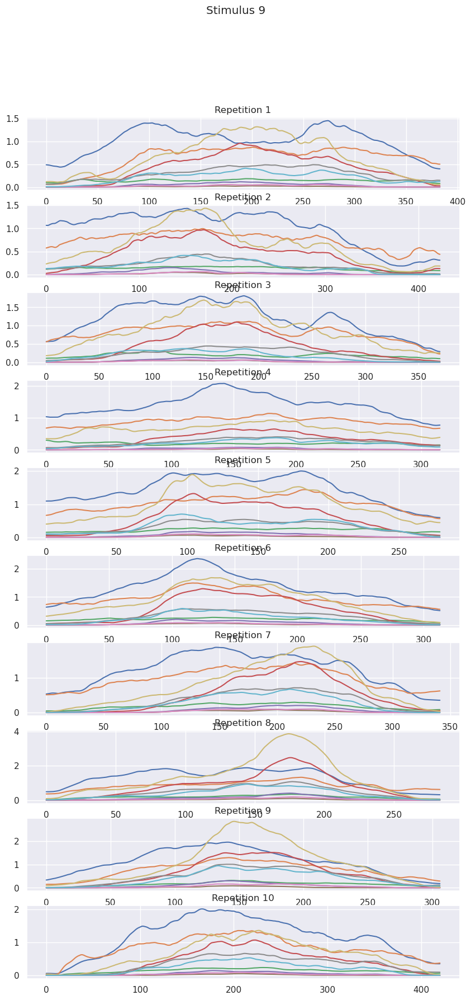

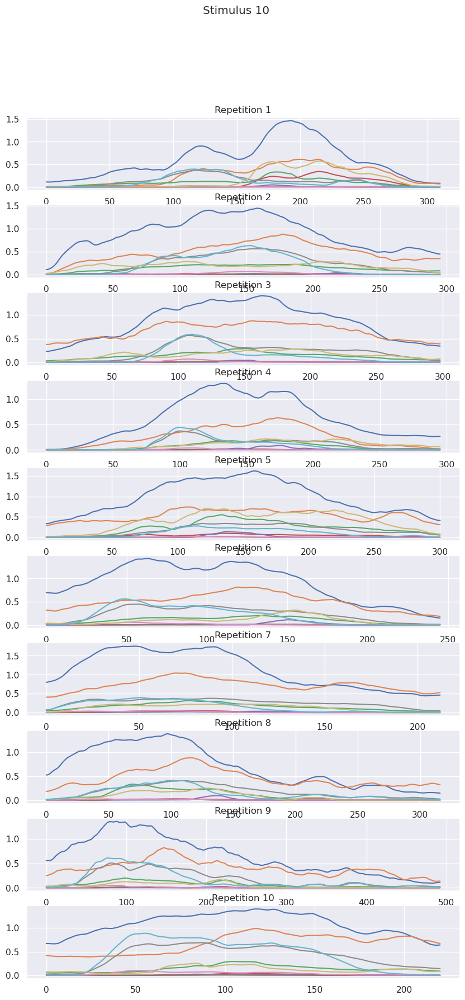

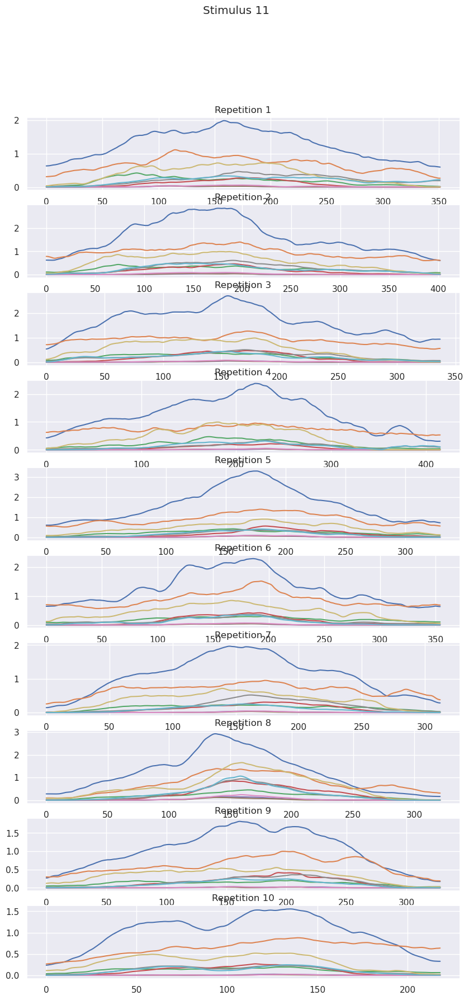

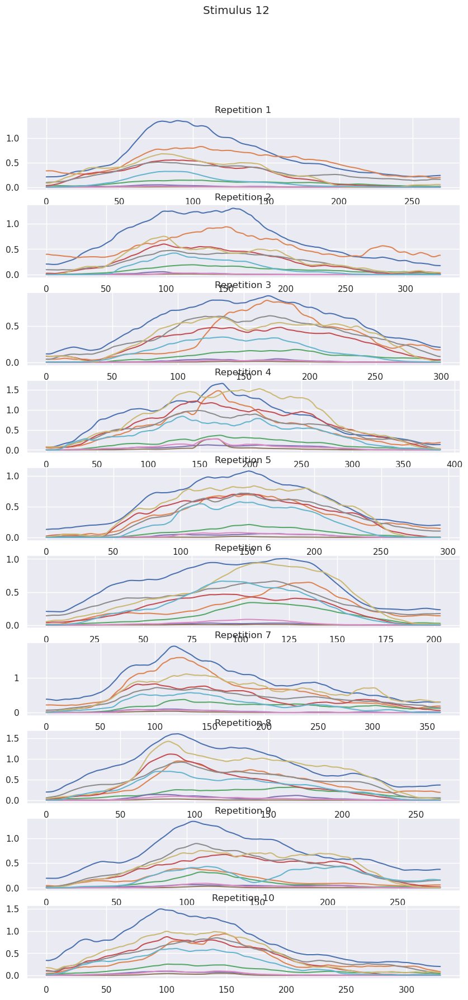

In [35]:
for s in range(n_stimuli):
    fig, ax = plt.subplots(n_repetitions, 1, figsize=(10, 2*n_repetitions))
    fig.suptitle(f"Stimulus {s+1}")
    for r in range(n_repetitions):
        ax[r].plot(emg_envelopes[s][r])
        ax[r].set_title(f"Repetition {r+1}")
